In [1]:
# Adaptado de:
# https://github.com/naokishibuya/deep-learning/blob/master/python/dcgan_celeba.ipynb

# Generación de caras con GANs

In [2]:
TRAIN    = True

COLAB    = True
GRAPHVIZ = True

In [3]:
if COLAB:
    %tensorflow_version 1.x
    !pip install h5py==2.10.0

TensorFlow 1.x selected.
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 2.9 MB 36.9 MB/s 
  Attempting uninstall: h5py
    Found existing installation: h5py 3.1.0
    Uninstalling h5py-3.1.0:
      Successfully uninstalled h5py-3.1.0


In [4]:
import numpy as np
from glob import glob
from tqdm import tqdm
import tensorflow as tf
import keras
import keras.backend as K
from keras.initializers import RandomNormal
from keras.layers import Dense, Activation, LeakyReLU, BatchNormalization
from keras.layers import Conv2D, Conv2DTranspose, Reshape, Flatten
from keras.models import Sequential
from keras.optimizers import Adam
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt
%matplotlib inline

Using TensorFlow backend.


## Leer base de datos

In [13]:
if COLAB:
    id_ = "1kD_GKuU2doz3TSNVi45_BbwvDZ2KmEei"
    aux = "'https://docs.google.com/uc?export=download&id={}&confirm=t'".format(id_)
    !wget $aux -O ./gender.zip
    !unzip ./gender.zip

--2022-06-25 06:41:15--  https://docs.google.com/uc?export=download&id=1kD_GKuU2doz3TSNVi45_BbwvDZ2KmEei&confirm=t
Resolving docs.google.com (docs.google.com)... 142.250.188.206, 2607:f8b0:4004:836::200e
Connecting to docs.google.com (docs.google.com)|142.250.188.206|:443... connected.
HTTP request sent, awaiting response... 303 See Other
Location: https://doc-0s-0c-docs.googleusercontent.com/docs/securesc/ha0ro937gcuc7l7deffksulhg5h7mbp1/6s19hemvog8vhv1ebq5ro0i9fhv1q5p5/1656139275000/03894129457800149408/*/1kD_GKuU2doz3TSNVi45_BbwvDZ2KmEei?e=download [following]
--2022-06-25 06:41:15--  https://doc-0s-0c-docs.googleusercontent.com/docs/securesc/ha0ro937gcuc7l7deffksulhg5h7mbp1/6s19hemvog8vhv1ebq5ro0i9fhv1q5p5/1656139275000/03894129457800149408/*/1kD_GKuU2doz3TSNVi45_BbwvDZ2KmEei?e=download
Resolving doc-0s-0c-docs.googleusercontent.com (doc-0s-0c-docs.googleusercontent.com)... 172.253.115.132, 2607:f8b0:4004:c06::84
Connecting to doc-0s-0c-docs.googleusercontent.com (doc-0s-0c-docs.go

In [16]:
filenames = np.array(glob('./gender/male/*.jpg'))
filenames

array(['./gender/male/Butch_Davis_0002.jpg',
       './gender/male/Adrien_Brody_0002.jpg',
       './gender/male/Carl_Levin_0001.jpg', ...,
       './gender/male/Aung_San_Suu_Kyi_0002.jpg',
       './gender/male/Al_Gore_0008.jpg',
       './gender/male/Bob_Graham_0004.jpg'], dtype='<U51')

Let's examine some sample images.

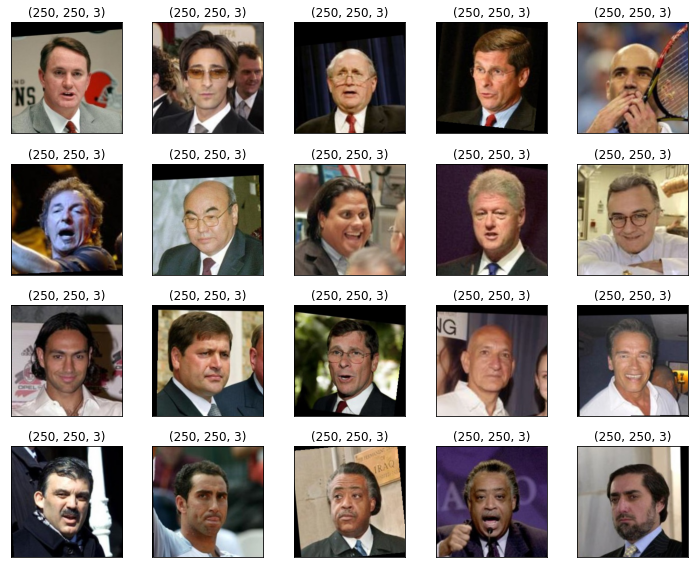

In [17]:
plt.figure(figsize=(10, 8))
for i in range(20):
    img = plt.imread(filenames[i])
    plt.subplot(4, 5, i+1)
    plt.imshow(img)
    plt.title(img.shape)
    plt.xticks([])
    plt.yticks([])
plt.tight_layout()

In [18]:
X_train, X_test = train_test_split(filenames, test_size=200)

In [19]:
print(X_train.shape)
print(X_test.shape)

(883,)
(200,)


## Preprocessing and Deprocessing

Those images are pretty big.  I'll crop and resize.

In [20]:
from PIL import Image

def load_image(filename, size=(32, 32)):
    img = np.array(Image.open(filename))
    # crop
    rows, cols = img.shape[:2]
    crop_r, crop_c = 150, 150
    start_row, start_col = (rows - crop_r) // 2, (cols - crop_c) // 2
    end_row, end_col = rows - start_row, cols - start_row
    img = img[start_row:end_row, start_col:end_col, :]
    # resize
    img = np.array(Image.fromarray(img).resize(size))
    return img

(32, 32, 3)
(32, 32, 3)
(32, 32, 3)
(32, 32, 3)
(32, 32, 3)
(32, 32, 3)
(32, 32, 3)
(32, 32, 3)
(32, 32, 3)
(32, 32, 3)
(32, 32, 3)
(32, 32, 3)
(32, 32, 3)
(32, 32, 3)
(32, 32, 3)
(32, 32, 3)
(32, 32, 3)
(32, 32, 3)
(32, 32, 3)
(32, 32, 3)


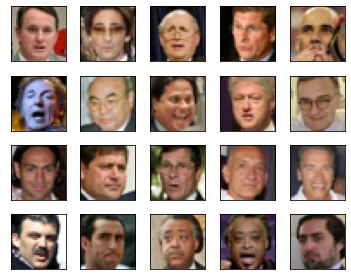

In [21]:
plt.figure(figsize=(5, 4))
for i in range(20):
    img = load_image(filenames[i])
    print(np.array(img).shape)
    plt.subplot(4, 5, i+1)
    plt.imshow(img)
    plt.xticks([])
    plt.yticks([])
plt.tight_layout()

As usual, we need preprocessing and later deprocessing of the images.  

As we will see later on, the generator is using `tanh` activation, for which we need to preprocess the image data into the range between -1 and 1.

In [22]:
def preprocess(x):
    return 2*(x/255)-1

def deprocess(x):
    return np.uint8((x+1)/2*255) # make sure to use uint8 type otherwise the image won't display properly

## Generator

The generator takes a latent sample (100 randomly generated numbers) and produces a color face image that should look like one from the CelebA dataset.

In [23]:
def make_generator(input_size, leaky_alpha, init_stddev):
    model = Sequential()
    model.add(Dense(512*4*4, input_shape=(input_size,)))
    model.add(Reshape(target_shape=(4,4,512))) # 512 imgs de 4x4
    model.add(BatchNormalization())
    model.add(LeakyReLU(alpha=leaky_alpha))
    model.add(Conv2DTranspose(256, kernel_size=5, strides=2, # upsampling + convolución
                              padding='same',
                              kernel_initializer=RandomNormal(stddev=init_stddev)
                             )) #  256 imgs de 8x8
    model.add(BatchNormalization())
    model.add(LeakyReLU(alpha=leaky_alpha))
    model.add(Conv2DTranspose(128, kernel_size=5, strides=2,
                              padding='same',
                              kernel_initializer=RandomNormal(stddev=init_stddev)
                             )) #  128 imgs de 16x16
    model.add(BatchNormalization())
    model.add(LeakyReLU(alpha=leaky_alpha))
    model.add(Conv2DTranspose(3, kernel_size=5, strides=2,
                              padding='same',
                              kernel_initializer=RandomNormal(stddev=init_stddev)
                             )) #  3 imgs de 32x32
    model.add(Activation('tanh'))
    
    return model


## Discriminator

The discriminator is a classifier to tell if the input image is real or fake.  

In [24]:
def make_discriminator(leaky_alpha, init_stddev):
    model = Sequential()
    model.add(Conv2D(64, kernel_size=5, strides=2,
                     padding='same', input_shape=(32,32,3),
                     kernel_initializer=RandomNormal(stddev=init_stddev)))
    model.add(LeakyReLU(alpha=leaky_alpha))
    model.add(Conv2D(128, kernel_size=5, strides=2,
                     padding='same',
                     kernel_initializer=RandomNormal(stddev=init_stddev)))
    model.add(BatchNormalization())
    model.add(LeakyReLU(alpha=leaky_alpha))
    model.add(Conv2D(256, kernel_size=5, strides=2,
                     padding='same',
                     kernel_initializer=RandomNormal(stddev=init_stddev)))
    model.add(BatchNormalization())
    model.add(LeakyReLU(alpha=leaky_alpha))
    model.add(Flatten())
    model.add(Dense(1,
                    kernel_initializer=RandomNormal(stddev=init_stddev)))
    model.add(Activation('sigmoid'))
    
    return model


## DCGAN

We connect the generator and the discriminator to make a DCGAN.

In [25]:
# beta_1 is the exponential decay rate for the 1st moment estimates in Adam optimizer
def make_DCGAN(sample_size, 
               g_learning_rate, 
               g_beta_1,
               d_learning_rate,
               d_beta_1,
               leaky_alpha,
               init_std):
    # generator
    generator = make_generator(sample_size, leaky_alpha, init_std)

    # discriminator
    discriminator = make_discriminator(leaky_alpha, init_std)
    discriminator.compile(optimizer=Adam(lr=d_learning_rate, beta_1=d_beta_1), loss='binary_crossentropy')
    
    # GAN
    gan = Sequential([generator, discriminator])
    gan.compile(optimizer=Adam(lr=g_learning_rate, beta_1=g_beta_1), loss='binary_crossentropy')
    
    return gan, generator, discriminator

## Training DCGAN

The below is a list of utility functions.

In [26]:
def make_latent_samples(n_samples, sample_size):
    #return np.random.uniform(-1, 1, size=(n_samples, sample_size))
    return np.random.normal(loc=0, scale=1, size=(n_samples, sample_size))

def make_trainable(model, trainable):
    for layer in model.layers:
        layer.trainable = trainable
        
def make_labels(size):
    return np.ones([size, 1]), np.zeros([size, 1])

def show_losses(losses):
    losses = np.array(losses)
    
    fig, ax = plt.subplots()
    plt.plot(losses.T[0], label='Discriminator')
    plt.plot(losses.T[1], label='Generator')
    plt.title("Validation Losses")
    plt.legend()
    plt.show()

def show_losses_and_errors(losses, errors):
    losses = np.array(losses)
    errors = np.array(errors)
    
    plt.figure(figsize=(15,5))
    plt.subplot(1,2,1)
    plt.plot(losses.T[0], label='Discriminator')
    plt.plot(losses.T[1], label='Generator')
    plt.title("Validation Losses")
    plt.legend()
    plt.subplot(1,2,2)
    plt.plot(errors.T[0], label='Discriminator')
    plt.plot(errors.T[1], label='Generator')
    plt.title("Validation Errors")
    plt.legend()
    plt.show()

def show_images(generated_images, cols=10):
    n_images = len(generated_images)
    rows = n_images//cols
    
    plt.figure(figsize=(10, 8))
    for i in range(n_images):
        img = deprocess(generated_images[i])
        ax = plt.subplot(rows, cols, i+1)
        plt.imshow(img)
        plt.xticks([])
        plt.yticks([])
    plt.tight_layout()
    plt.show()

### Training

Smaller learning rate for the generater and a bigger learning rate for the discriminator.

In [27]:
g_learning_rate=0.0001
g_beta_1=0.5
d_learning_rate=0.001
d_beta_1=0.5
leaky_alpha=0.2
init_std=0.02


smooth=0.1
sample_size=100 # latent sample size (i.e. 100 random numbers)
epochs=100 # 3
batch_size=16 # 128  # train batch size
eval_size=16    # evaluate size

# labels for the batch size and the test size
y_train_real, y_train_fake = make_labels(batch_size)
y_eval_real,  y_eval_fake  = make_labels(eval_size)

# create a GAN, a generator and a discriminator
gan, generator, discriminator = make_DCGAN(
    sample_size, 
    g_learning_rate, 
    g_beta_1,
    d_learning_rate,
    d_beta_1,
    leaky_alpha,
    init_std)

losses = []
errors = []

Instructions for updating:
If using Keras pass *_constraint arguments to layers.
Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where


Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1 (Dense)              (None, 8192)              827392    
_________________________________________________________________
reshape_1 (Reshape)          (None, 4, 4, 512)         0         
_________________________________________________________________
batch_normalization_1 (Batch (None, 4, 4, 512)         2048      
_________________________________________________________________
leaky_re_lu_1 (LeakyReLU)    (None, 4, 4, 512)         0         
_________________________________________________________________
conv2d_transpose_1 (Conv2DTr (None, 8, 8, 256)         3277056   
_________________________________________________________________
batch_normalization_2 (Batch (None, 8, 8, 256)         1024      
_________________________________________________________________
leaky_re_lu_2 (LeakyReLU)    (None, 8, 8, 256)        

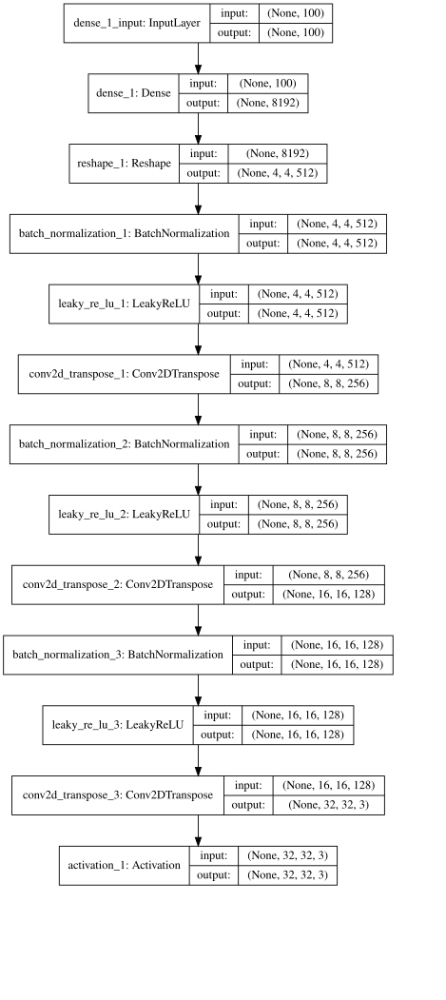

In [28]:
print(generator.summary())
if GRAPHVIZ:
    from IPython.display import SVG,display
    from keras.utils.vis_utils import model_to_dot
    if COLAB:
        display(SVG(model_to_dot(generator,show_shapes=True,dpi=64).create(prog='dot', format='svg')))
    else:
        display(SVG(model_to_dot(generator,show_shapes=True).create(prog='dot', format='svg')))

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_1 (Conv2D)            (None, 16, 16, 64)        4864      
_________________________________________________________________
leaky_re_lu_4 (LeakyReLU)    (None, 16, 16, 64)        0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 8, 8, 128)         204928    
_________________________________________________________________
batch_normalization_4 (Batch (None, 8, 8, 128)         512       
_________________________________________________________________
leaky_re_lu_5 (LeakyReLU)    (None, 8, 8, 128)         0         
_________________________________________________________________
conv2d_3 (Conv2D)            (None, 4, 4, 256)         819456    
_________________________________________________________________
batch_normalization_5 (Batch (None, 4, 4, 256)        

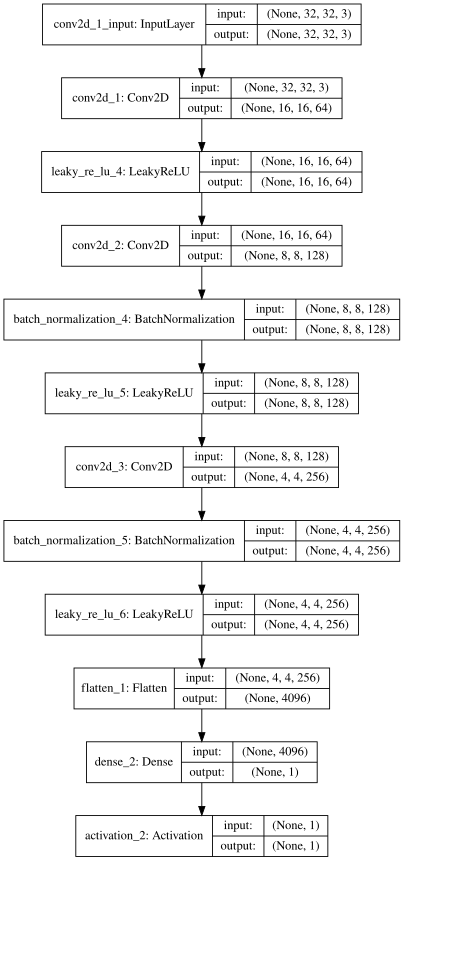

In [29]:
print(discriminator.summary())
if GRAPHVIZ:
    if COLAB:
        display(SVG(model_to_dot(discriminator,show_shapes=True,dpi=64).create(prog='dot', format='svg')))
    else:
        display(SVG(model_to_dot(discriminator,show_shapes=True).create(prog='dot', format='svg')))

Model: "sequential_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
sequential_1 (Sequential)    (None, 32, 32, 3)         4936963   
_________________________________________________________________
sequential_2 (Sequential)    (None, 1)                 1034881   
Total params: 5,971,844
Trainable params: 5,969,284
Non-trainable params: 2,560
_________________________________________________________________
None


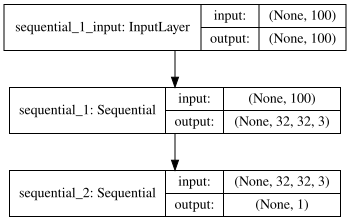

In [30]:
print(gan.summary())
if GRAPHVIZ:
    if COLAB:
        display(SVG(model_to_dot(gan,show_shapes=True,dpi=72).create(prog='dot', format='svg')))
    else:
        display(SVG(model_to_dot(gan,show_shapes=True).create(prog='dot', format='svg')))

  0%|          | 0/55 [00:00<?, ?it/s]/tensorflow-1.15.2/python3.7/keras/engine/training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'
100%|██████████| 55/55 [00:03<00:00, 13.89it/s]


Epoch:   1/100 Discriminator Loss: 2.9928 Generator Loss: 3.3608


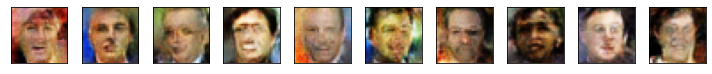

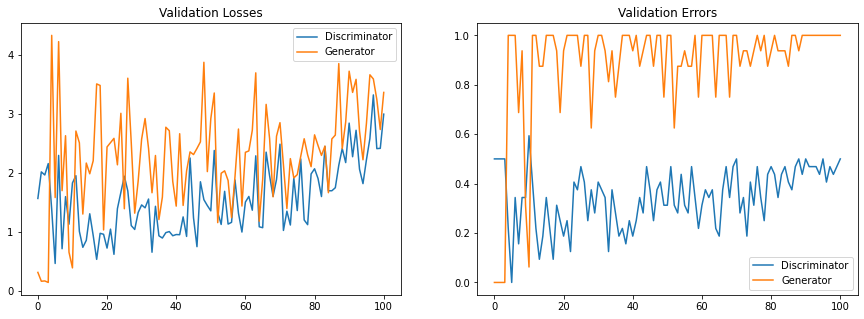

  0%|          | 0/55 [00:00<?, ?it/s]/tensorflow-1.15.2/python3.7/keras/engine/training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'
100%|██████████| 55/55 [00:03<00:00, 14.53it/s]


Epoch:   2/100 Discriminator Loss: 2.8736 Generator Loss: 3.4501


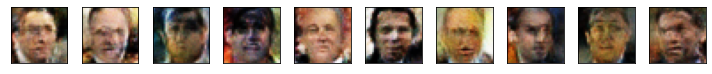

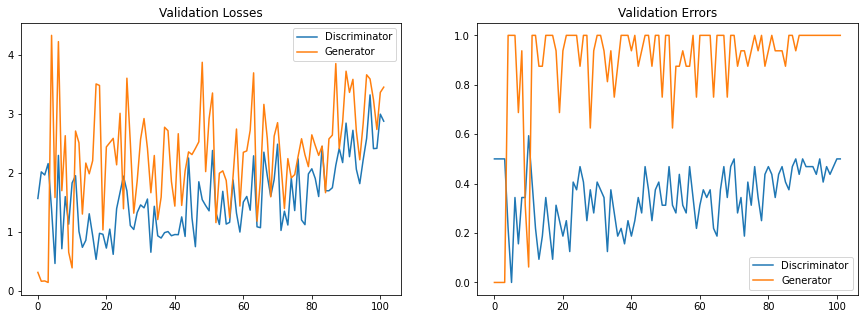

  0%|          | 0/55 [00:00<?, ?it/s]/tensorflow-1.15.2/python3.7/keras/engine/training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'
100%|██████████| 55/55 [00:03<00:00, 14.45it/s]


Epoch:   3/100 Discriminator Loss: 2.5489 Generator Loss: 2.4595


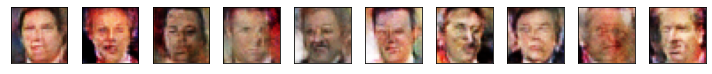

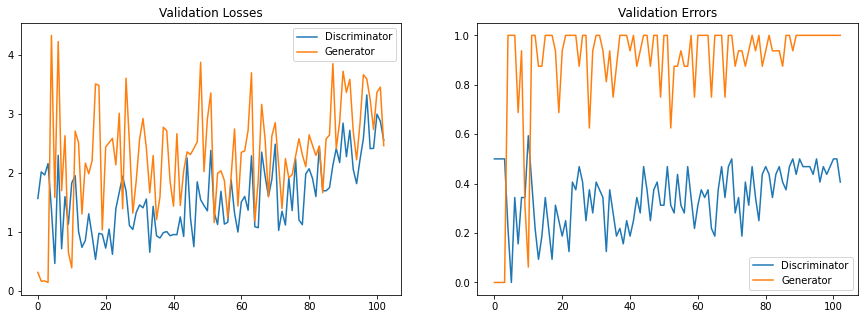

  0%|          | 0/55 [00:00<?, ?it/s]/tensorflow-1.15.2/python3.7/keras/engine/training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'
100%|██████████| 55/55 [00:03<00:00, 14.14it/s]


Epoch:   4/100 Discriminator Loss: 2.2819 Generator Loss: 3.0699


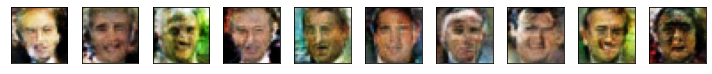

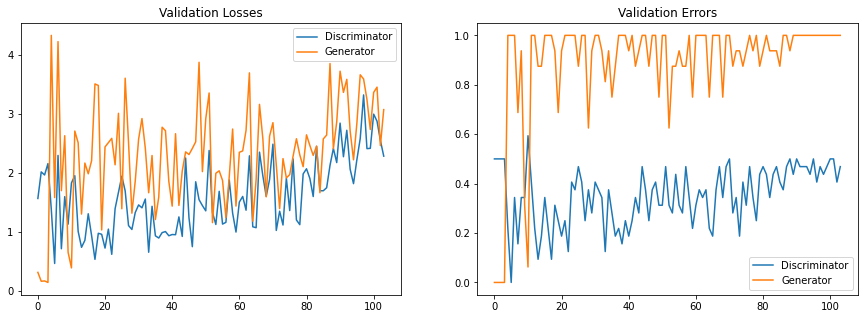

  0%|          | 0/55 [00:00<?, ?it/s]/tensorflow-1.15.2/python3.7/keras/engine/training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'
100%|██████████| 55/55 [00:03<00:00, 13.95it/s]


Epoch:   5/100 Discriminator Loss: 2.3928 Generator Loss: 1.6482


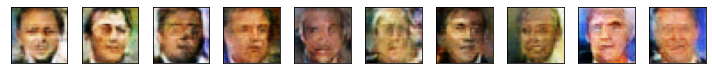

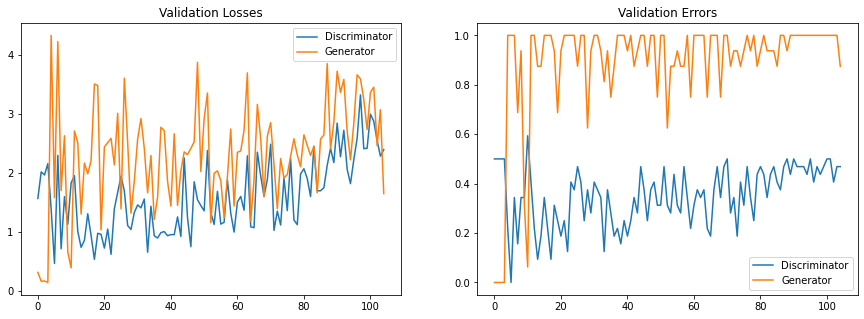

  0%|          | 0/55 [00:00<?, ?it/s]/tensorflow-1.15.2/python3.7/keras/engine/training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'
100%|██████████| 55/55 [00:04<00:00, 13.70it/s]


Epoch:   6/100 Discriminator Loss: 2.7522 Generator Loss: 4.1990


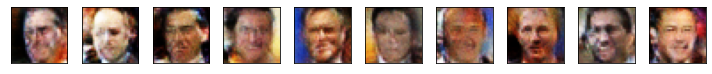

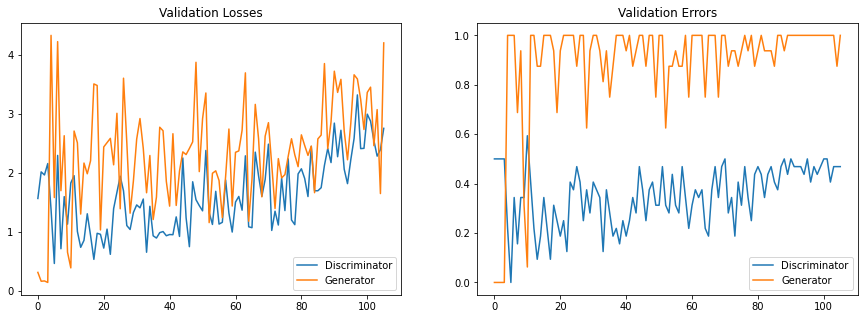

  0%|          | 0/55 [00:00<?, ?it/s]/tensorflow-1.15.2/python3.7/keras/engine/training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'
100%|██████████| 55/55 [00:04<00:00, 13.73it/s]


Epoch:   7/100 Discriminator Loss: 2.7564 Generator Loss: 2.6156


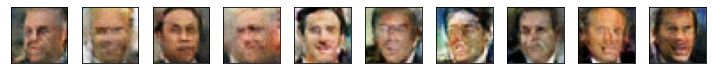

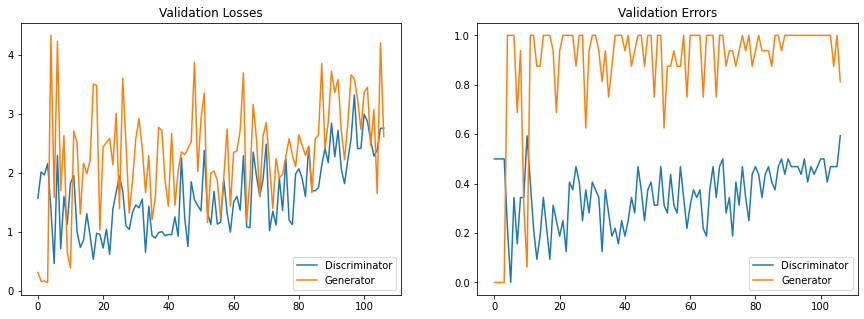

  0%|          | 0/55 [00:00<?, ?it/s]/tensorflow-1.15.2/python3.7/keras/engine/training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'
100%|██████████| 55/55 [00:04<00:00, 13.61it/s]


Epoch:   8/100 Discriminator Loss: 2.8700 Generator Loss: 3.6336


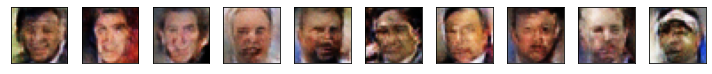

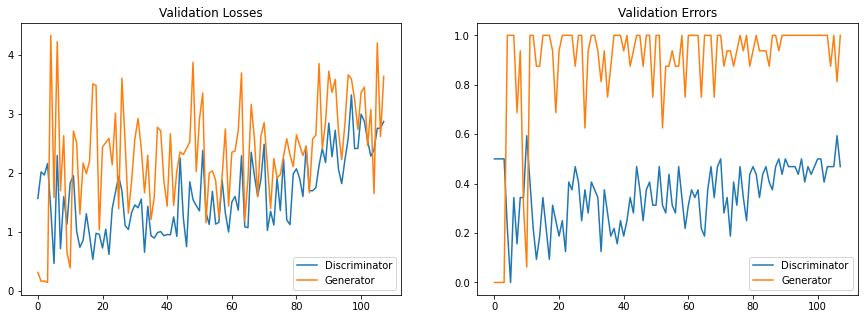

  0%|          | 0/55 [00:00<?, ?it/s]/tensorflow-1.15.2/python3.7/keras/engine/training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'
100%|██████████| 55/55 [00:04<00:00, 12.05it/s]


Epoch:   9/100 Discriminator Loss: 2.7680 Generator Loss: 3.2335


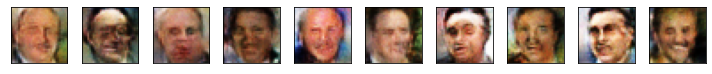

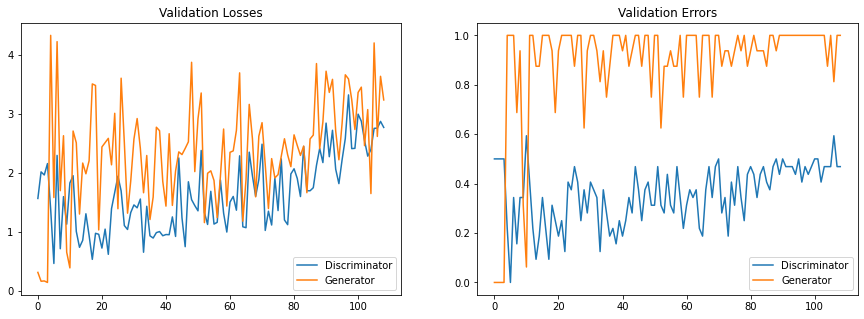

  0%|          | 0/55 [00:00<?, ?it/s]/tensorflow-1.15.2/python3.7/keras/engine/training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'
100%|██████████| 55/55 [00:03<00:00, 13.91it/s]


Epoch:  10/100 Discriminator Loss: 3.0485 Generator Loss: 3.9223


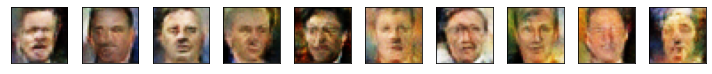

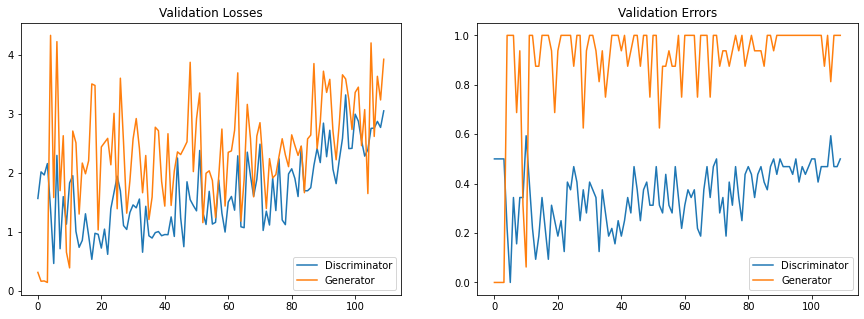

  0%|          | 0/55 [00:00<?, ?it/s]/tensorflow-1.15.2/python3.7/keras/engine/training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'
100%|██████████| 55/55 [00:04<00:00, 13.39it/s]


Epoch:  11/100 Discriminator Loss: 2.8902 Generator Loss: 3.3275


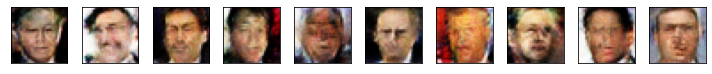

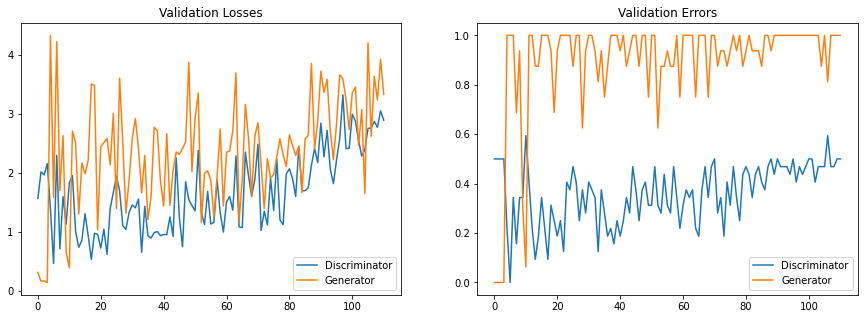

  0%|          | 0/55 [00:00<?, ?it/s]/tensorflow-1.15.2/python3.7/keras/engine/training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'
100%|██████████| 55/55 [00:04<00:00, 13.11it/s]


Epoch:  12/100 Discriminator Loss: 3.5222 Generator Loss: 3.2816


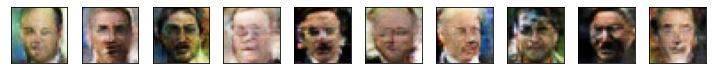

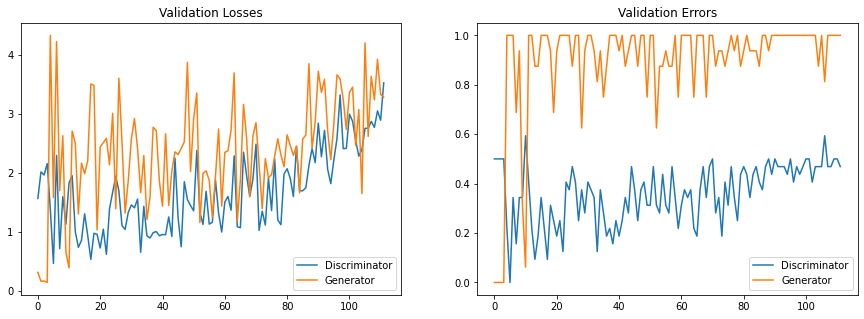

  0%|          | 0/55 [00:00<?, ?it/s]/tensorflow-1.15.2/python3.7/keras/engine/training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'
100%|██████████| 55/55 [00:04<00:00, 13.33it/s]


Epoch:  13/100 Discriminator Loss: 2.6972 Generator Loss: 2.5637


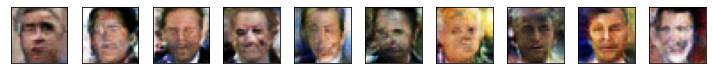

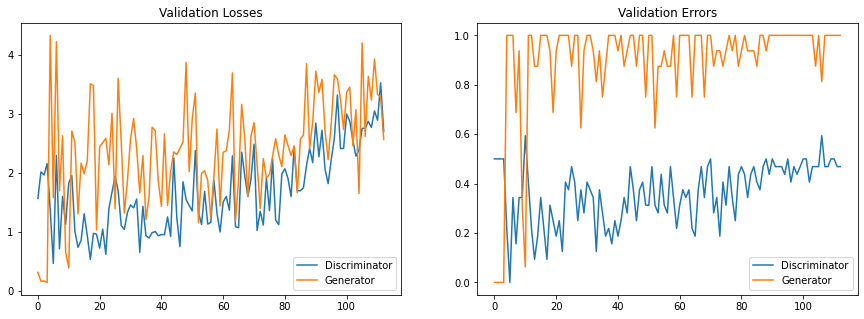

  0%|          | 0/55 [00:00<?, ?it/s]/tensorflow-1.15.2/python3.7/keras/engine/training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'
100%|██████████| 55/55 [00:04<00:00, 13.03it/s]


Epoch:  14/100 Discriminator Loss: 3.2271 Generator Loss: 2.9803


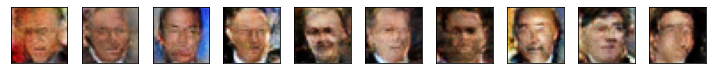

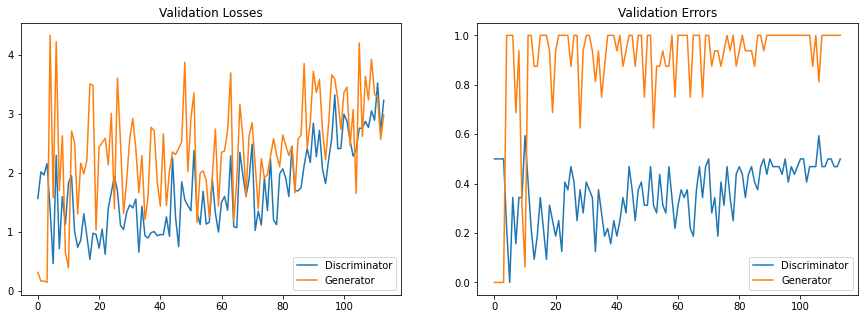

  0%|          | 0/55 [00:00<?, ?it/s]/tensorflow-1.15.2/python3.7/keras/engine/training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'
100%|██████████| 55/55 [00:04<00:00, 13.30it/s]


Epoch:  15/100 Discriminator Loss: 2.7359 Generator Loss: 2.7656


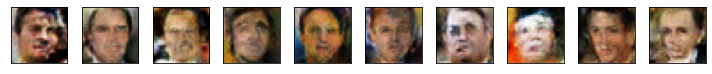

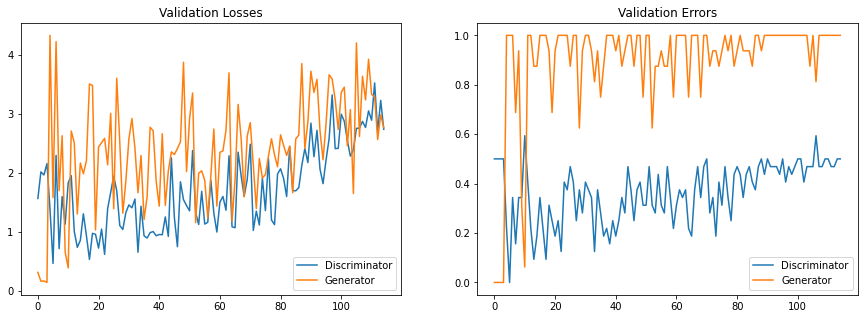

  0%|          | 0/55 [00:00<?, ?it/s]/tensorflow-1.15.2/python3.7/keras/engine/training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'
100%|██████████| 55/55 [00:04<00:00, 13.27it/s]


Epoch:  16/100 Discriminator Loss: 2.4041 Generator Loss: 2.3226


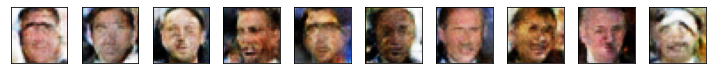

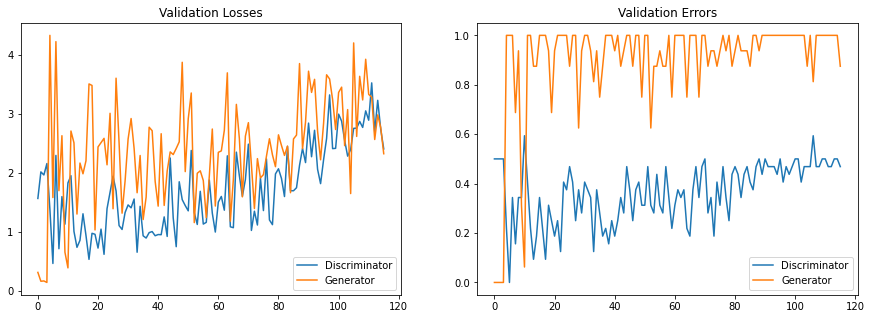

  0%|          | 0/55 [00:00<?, ?it/s]/tensorflow-1.15.2/python3.7/keras/engine/training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'
100%|██████████| 55/55 [00:04<00:00, 12.96it/s]


Epoch:  17/100 Discriminator Loss: 3.1057 Generator Loss: 3.6915


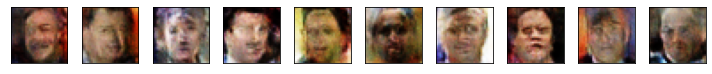

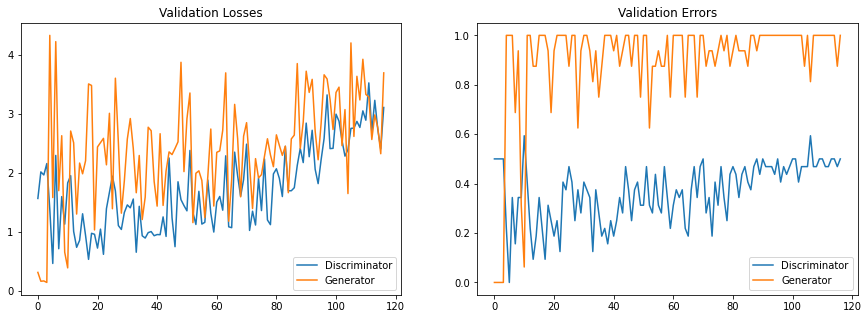

  0%|          | 0/55 [00:00<?, ?it/s]/tensorflow-1.15.2/python3.7/keras/engine/training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'
100%|██████████| 55/55 [00:04<00:00, 12.59it/s]


Epoch:  18/100 Discriminator Loss: 4.0458 Generator Loss: 2.7930


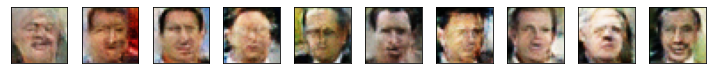

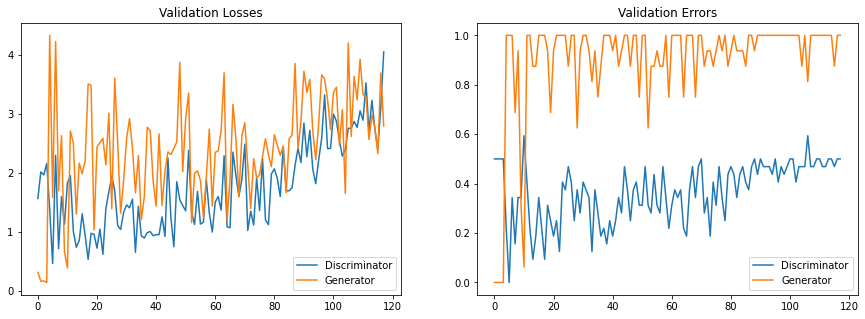

  0%|          | 0/55 [00:00<?, ?it/s]/tensorflow-1.15.2/python3.7/keras/engine/training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'
100%|██████████| 55/55 [00:04<00:00, 12.76it/s]


Epoch:  19/100 Discriminator Loss: 2.7226 Generator Loss: 2.7544


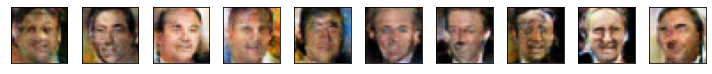

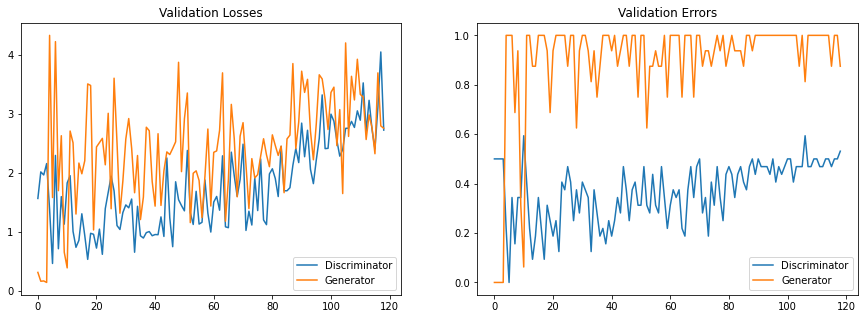

  0%|          | 0/55 [00:00<?, ?it/s]/tensorflow-1.15.2/python3.7/keras/engine/training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'
100%|██████████| 55/55 [00:04<00:00, 12.90it/s]


Epoch:  20/100 Discriminator Loss: 3.2651 Generator Loss: 2.8394


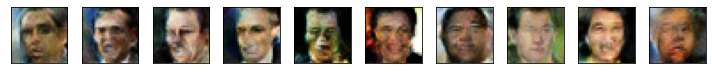

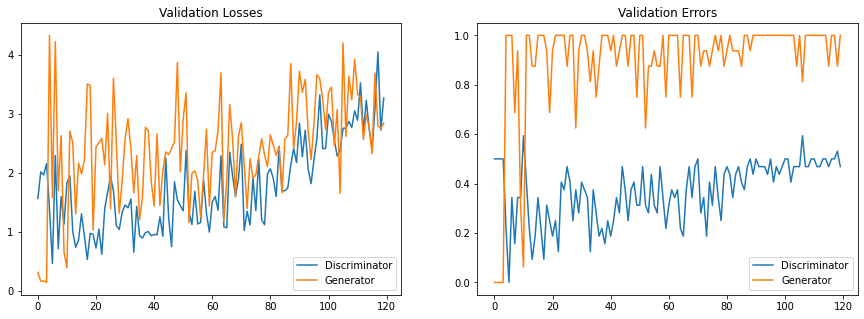

  0%|          | 0/55 [00:00<?, ?it/s]/tensorflow-1.15.2/python3.7/keras/engine/training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'
100%|██████████| 55/55 [00:04<00:00, 12.52it/s]


Epoch:  21/100 Discriminator Loss: 3.1100 Generator Loss: 3.2339


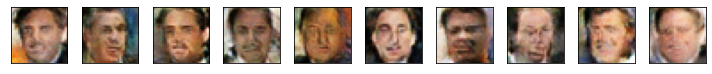

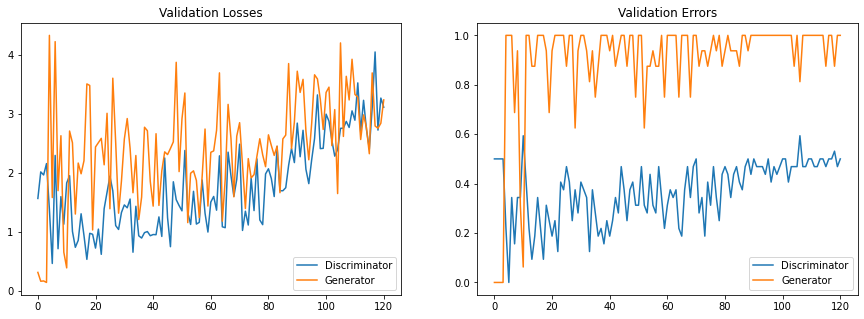

  0%|          | 0/55 [00:00<?, ?it/s]/tensorflow-1.15.2/python3.7/keras/engine/training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'
100%|██████████| 55/55 [00:04<00:00, 12.71it/s]


Epoch:  22/100 Discriminator Loss: 2.7843 Generator Loss: 2.8685


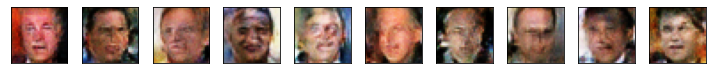

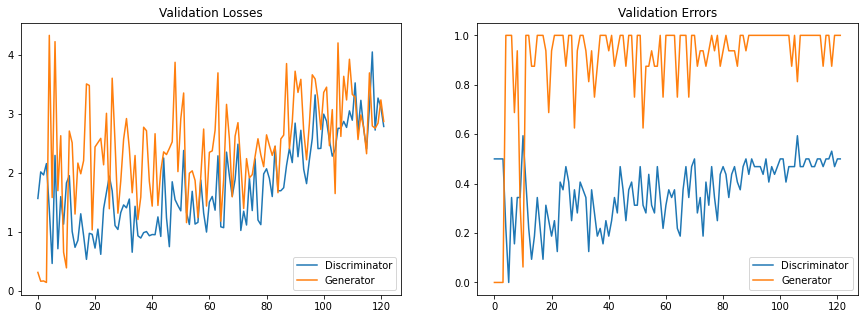

  0%|          | 0/55 [00:00<?, ?it/s]/tensorflow-1.15.2/python3.7/keras/engine/training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'
100%|██████████| 55/55 [00:04<00:00, 12.33it/s]


Epoch:  23/100 Discriminator Loss: 3.5884 Generator Loss: 3.7124


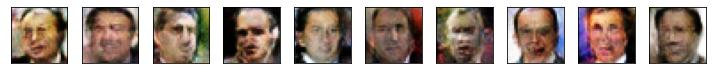

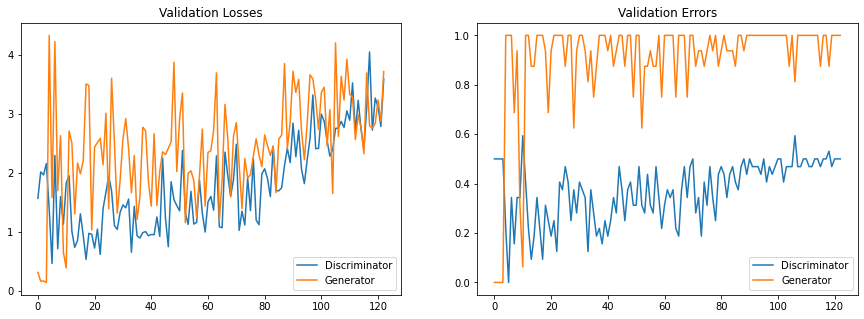

  0%|          | 0/55 [00:00<?, ?it/s]/tensorflow-1.15.2/python3.7/keras/engine/training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'
100%|██████████| 55/55 [00:04<00:00, 12.25it/s]


Epoch:  24/100 Discriminator Loss: 3.1523 Generator Loss: 2.7967


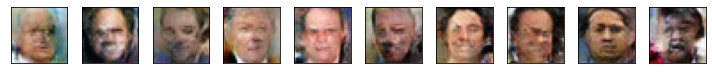

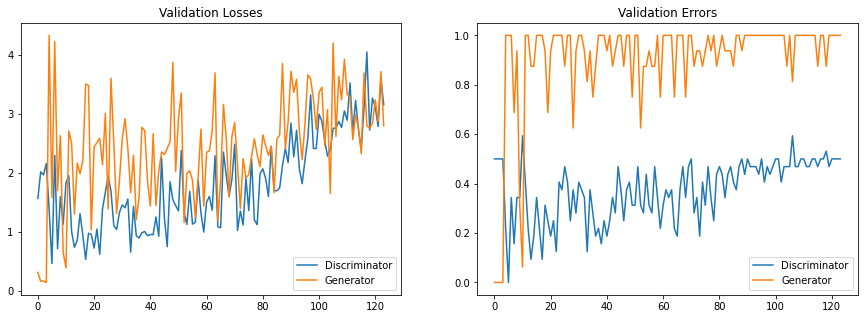

  0%|          | 0/55 [00:00<?, ?it/s]/tensorflow-1.15.2/python3.7/keras/engine/training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'
100%|██████████| 55/55 [00:04<00:00, 12.31it/s]


Epoch:  25/100 Discriminator Loss: 3.0448 Generator Loss: 2.5282


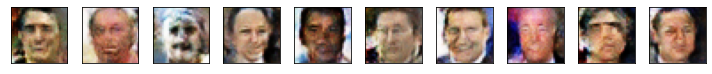

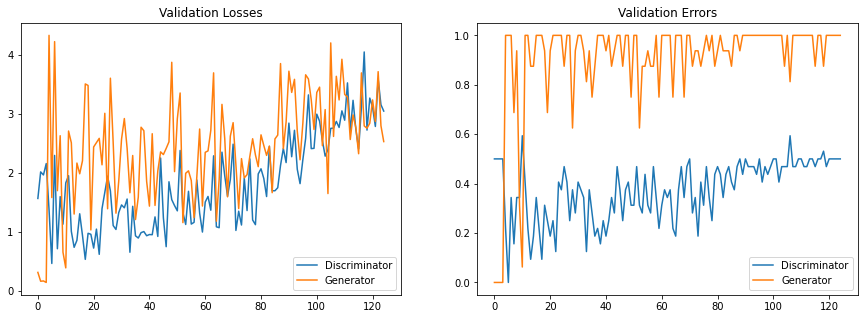

  0%|          | 0/55 [00:00<?, ?it/s]/tensorflow-1.15.2/python3.7/keras/engine/training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'
100%|██████████| 55/55 [00:04<00:00, 12.15it/s]


Epoch:  26/100 Discriminator Loss: 2.7087 Generator Loss: 3.5257


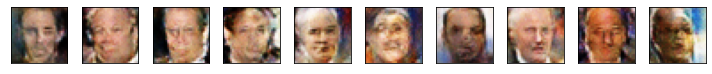

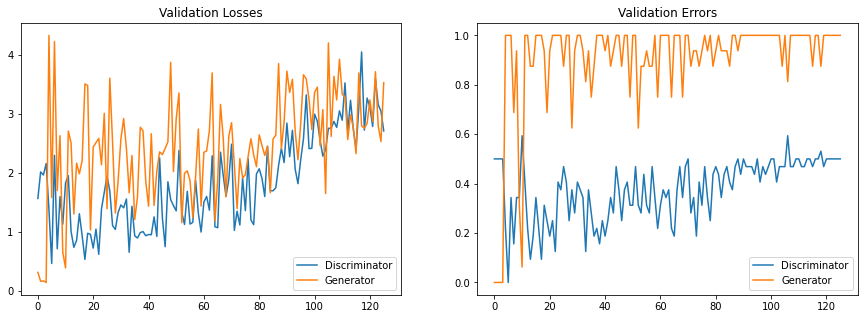

  0%|          | 0/55 [00:00<?, ?it/s]/tensorflow-1.15.2/python3.7/keras/engine/training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'
100%|██████████| 55/55 [00:04<00:00, 12.40it/s]


Epoch:  27/100 Discriminator Loss: 3.2509 Generator Loss: 2.9164


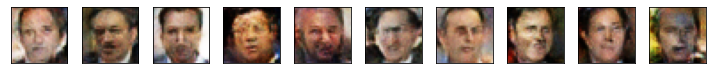

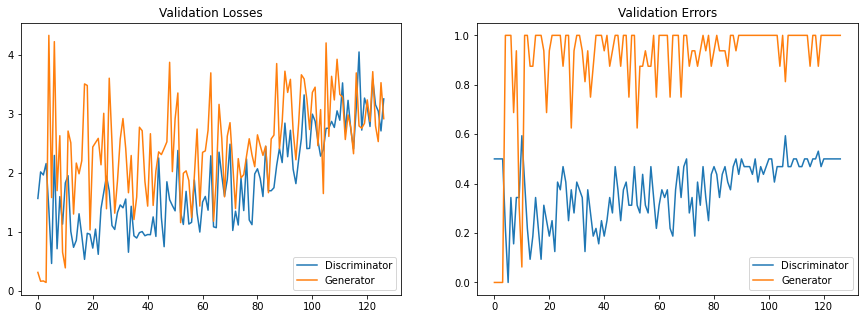

  0%|          | 0/55 [00:00<?, ?it/s]/tensorflow-1.15.2/python3.7/keras/engine/training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'
100%|██████████| 55/55 [00:04<00:00, 12.22it/s]


Epoch:  28/100 Discriminator Loss: 3.7062 Generator Loss: 3.2160


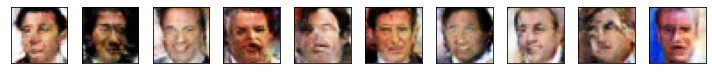

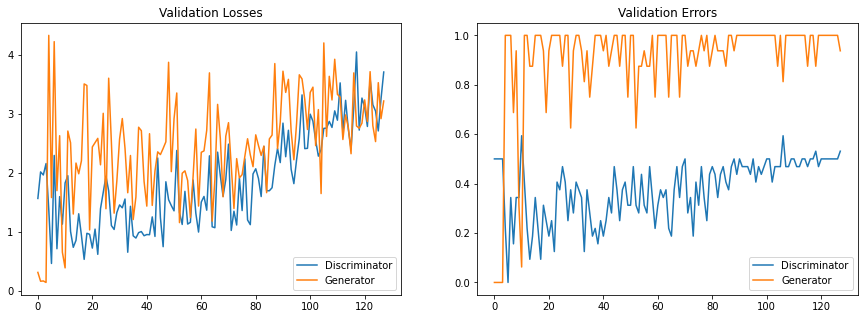

  0%|          | 0/55 [00:00<?, ?it/s]/tensorflow-1.15.2/python3.7/keras/engine/training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'
100%|██████████| 55/55 [00:04<00:00, 12.25it/s]


Epoch:  29/100 Discriminator Loss: 3.7099 Generator Loss: 3.4552


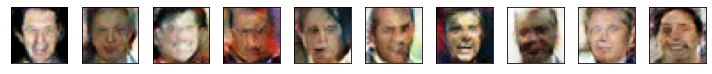

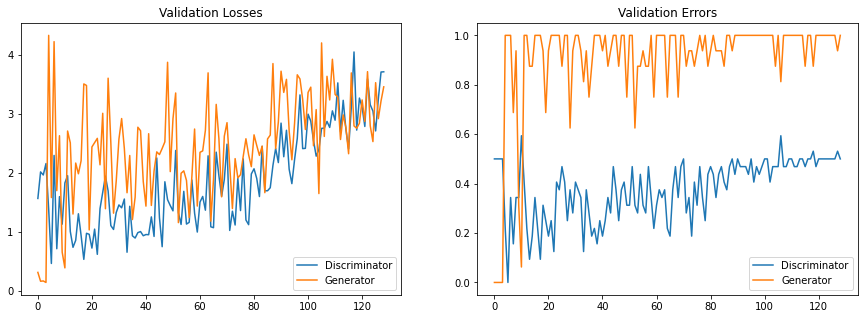

  0%|          | 0/55 [00:00<?, ?it/s]/tensorflow-1.15.2/python3.7/keras/engine/training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'
100%|██████████| 55/55 [00:04<00:00, 11.88it/s]


Epoch:  30/100 Discriminator Loss: 3.4330 Generator Loss: 3.7077


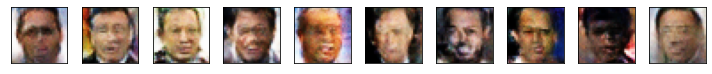

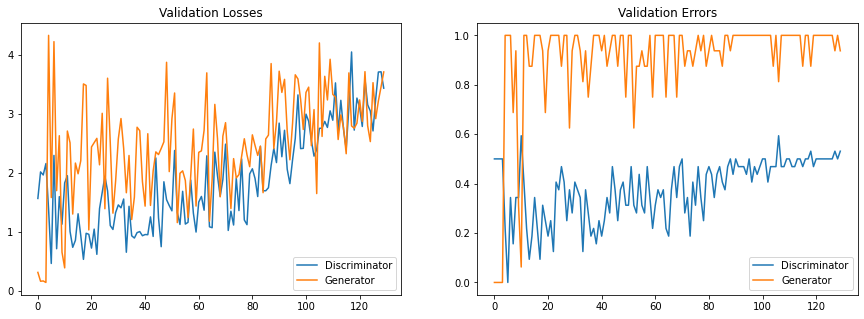

  0%|          | 0/55 [00:00<?, ?it/s]/tensorflow-1.15.2/python3.7/keras/engine/training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'
100%|██████████| 55/55 [00:04<00:00, 11.65it/s]


Epoch:  31/100 Discriminator Loss: 4.1960 Generator Loss: 4.1602


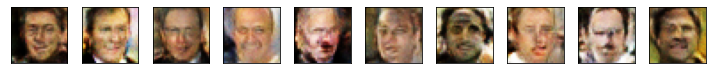

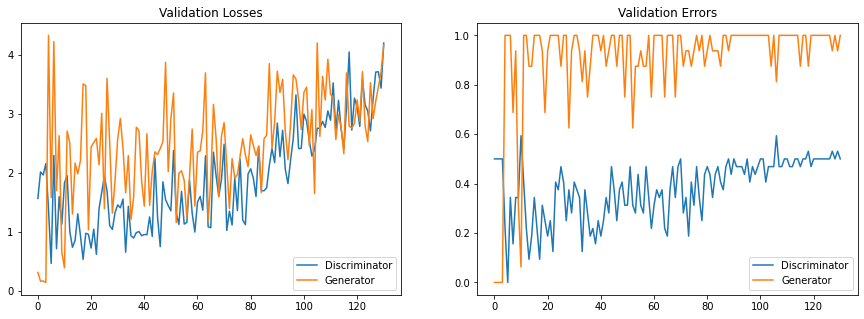

  0%|          | 0/55 [00:00<?, ?it/s]/tensorflow-1.15.2/python3.7/keras/engine/training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'
100%|██████████| 55/55 [00:04<00:00, 12.26it/s]


Epoch:  32/100 Discriminator Loss: 3.2302 Generator Loss: 2.6223


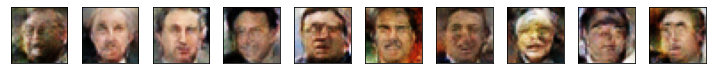

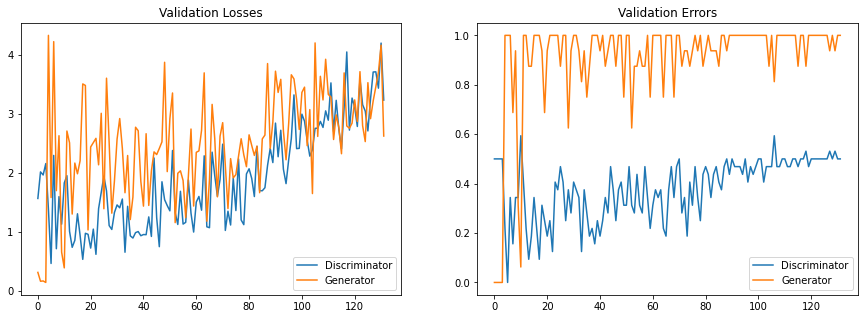

  0%|          | 0/55 [00:00<?, ?it/s]/tensorflow-1.15.2/python3.7/keras/engine/training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'
100%|██████████| 55/55 [00:04<00:00, 12.02it/s]


Epoch:  33/100 Discriminator Loss: 3.8725 Generator Loss: 3.9189


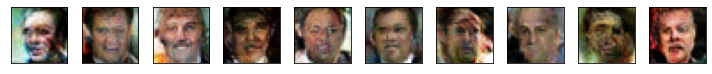

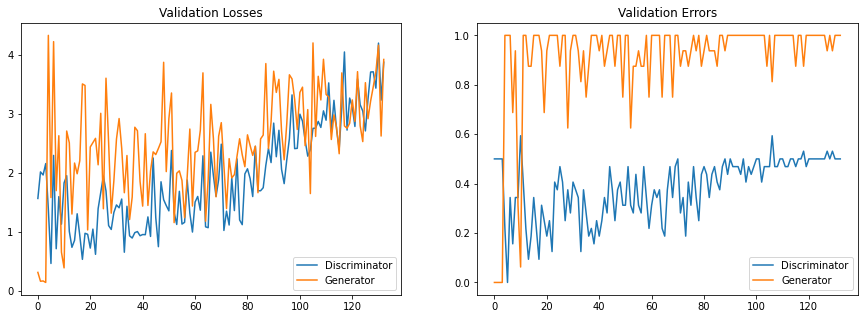

  0%|          | 0/55 [00:00<?, ?it/s]/tensorflow-1.15.2/python3.7/keras/engine/training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'
100%|██████████| 55/55 [00:04<00:00, 11.79it/s]


Epoch:  34/100 Discriminator Loss: 3.0389 Generator Loss: 3.3208


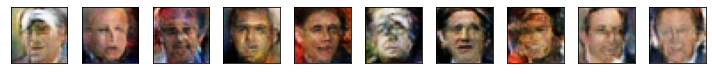

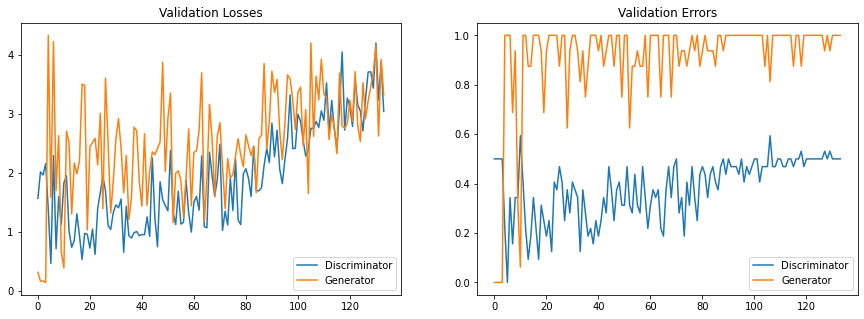

  0%|          | 0/55 [00:00<?, ?it/s]/tensorflow-1.15.2/python3.7/keras/engine/training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'
100%|██████████| 55/55 [00:04<00:00, 11.78it/s]


Epoch:  35/100 Discriminator Loss: 2.4387 Generator Loss: 1.7432


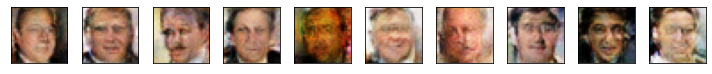

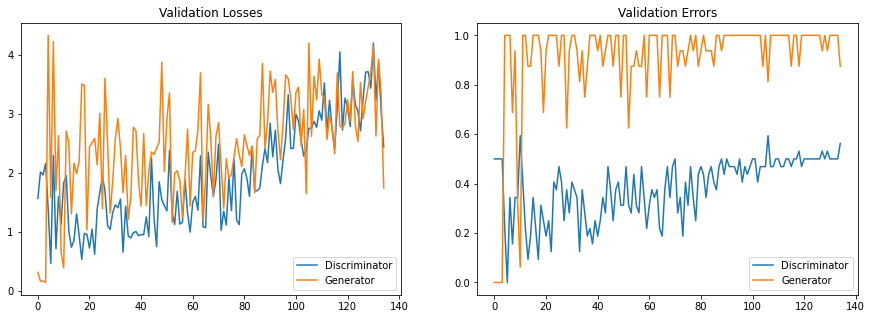

  0%|          | 0/55 [00:00<?, ?it/s]/tensorflow-1.15.2/python3.7/keras/engine/training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'
100%|██████████| 55/55 [00:04<00:00, 11.53it/s]


Epoch:  36/100 Discriminator Loss: 2.8873 Generator Loss: 3.5904


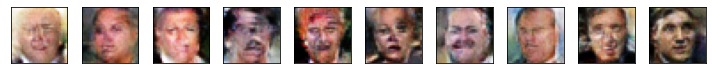

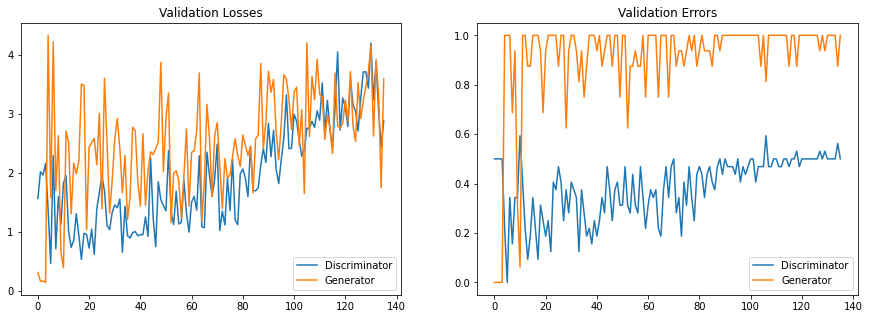

  0%|          | 0/55 [00:00<?, ?it/s]/tensorflow-1.15.2/python3.7/keras/engine/training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'
100%|██████████| 55/55 [00:04<00:00, 11.82it/s]


Epoch:  37/100 Discriminator Loss: 3.2913 Generator Loss: 2.9097


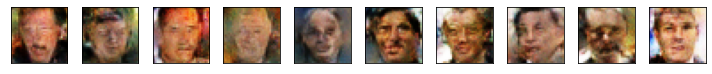

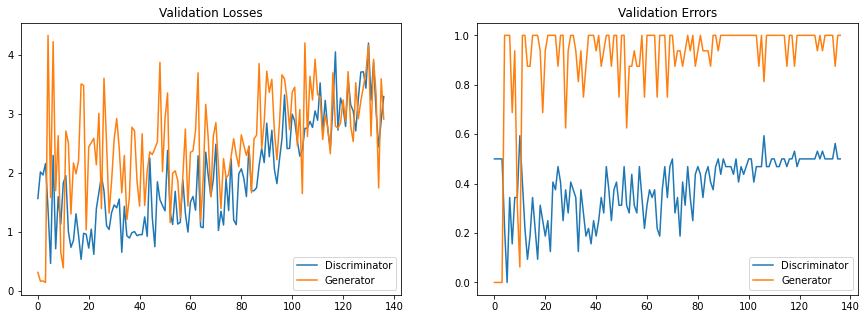

  0%|          | 0/55 [00:00<?, ?it/s]/tensorflow-1.15.2/python3.7/keras/engine/training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'
100%|██████████| 55/55 [00:04<00:00, 11.70it/s]


Epoch:  38/100 Discriminator Loss: 4.4234 Generator Loss: 3.1246


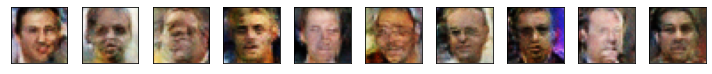

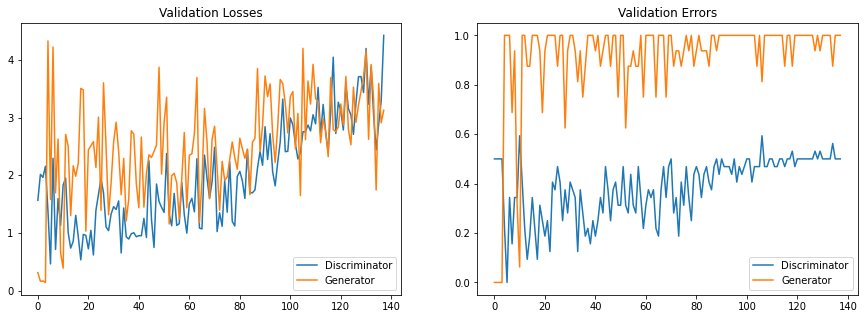

  0%|          | 0/55 [00:00<?, ?it/s]/tensorflow-1.15.2/python3.7/keras/engine/training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'
100%|██████████| 55/55 [00:04<00:00, 11.79it/s]


Epoch:  39/100 Discriminator Loss: 3.2497 Generator Loss: 2.5445


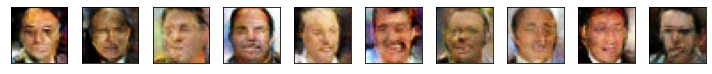

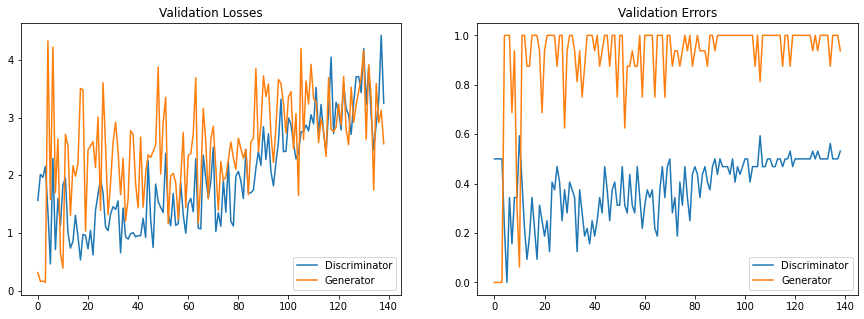

  0%|          | 0/55 [00:00<?, ?it/s]/tensorflow-1.15.2/python3.7/keras/engine/training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'
100%|██████████| 55/55 [00:04<00:00, 11.37it/s]


Epoch:  40/100 Discriminator Loss: 3.2811 Generator Loss: 2.7911


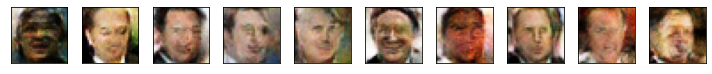

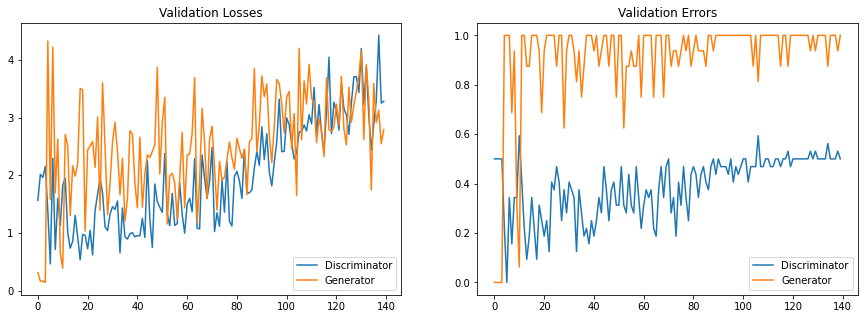

  0%|          | 0/55 [00:00<?, ?it/s]/tensorflow-1.15.2/python3.7/keras/engine/training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'
100%|██████████| 55/55 [00:04<00:00, 11.50it/s]


Epoch:  41/100 Discriminator Loss: 3.7651 Generator Loss: 3.3002


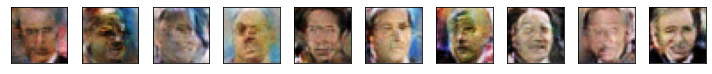

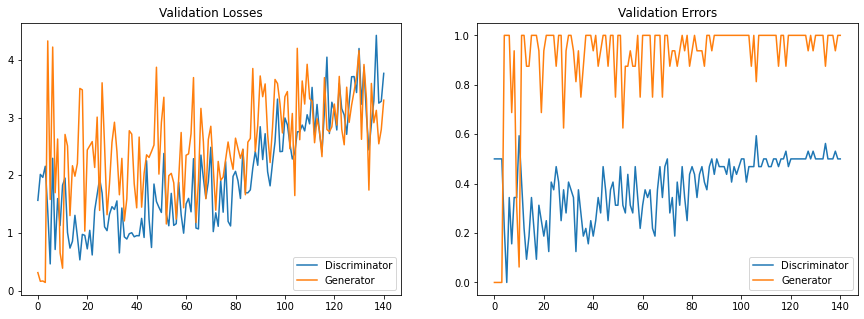

  0%|          | 0/55 [00:00<?, ?it/s]/tensorflow-1.15.2/python3.7/keras/engine/training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'
100%|██████████| 55/55 [00:05<00:00, 10.71it/s]


Epoch:  42/100 Discriminator Loss: 2.8225 Generator Loss: 2.5410


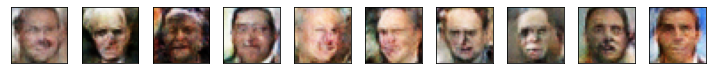

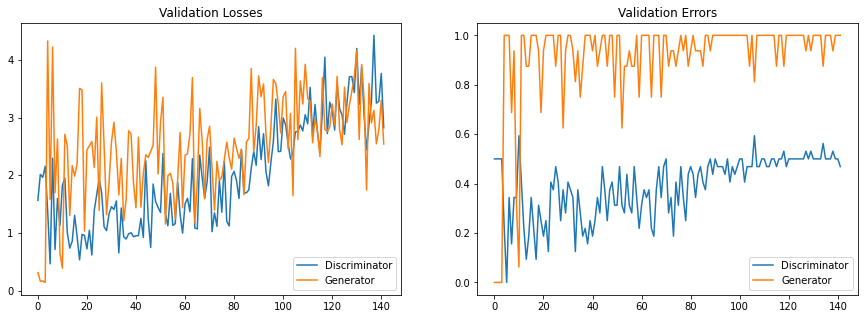

  0%|          | 0/55 [00:00<?, ?it/s]/tensorflow-1.15.2/python3.7/keras/engine/training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'
100%|██████████| 55/55 [00:05<00:00, 10.82it/s]


Epoch:  43/100 Discriminator Loss: 3.4174 Generator Loss: 2.9681


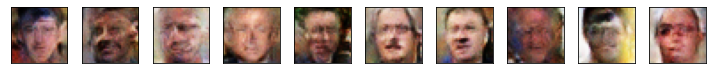

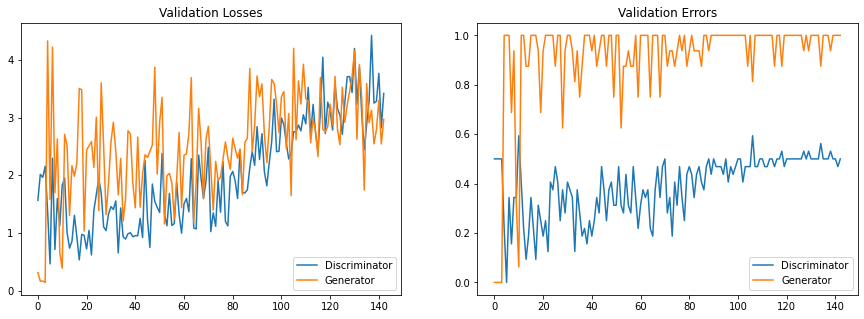

  0%|          | 0/55 [00:00<?, ?it/s]/tensorflow-1.15.2/python3.7/keras/engine/training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'
100%|██████████| 55/55 [00:04<00:00, 11.51it/s]


Epoch:  44/100 Discriminator Loss: 3.9092 Generator Loss: 3.3671


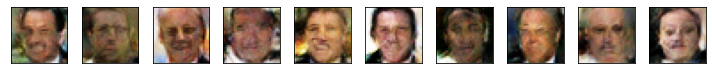

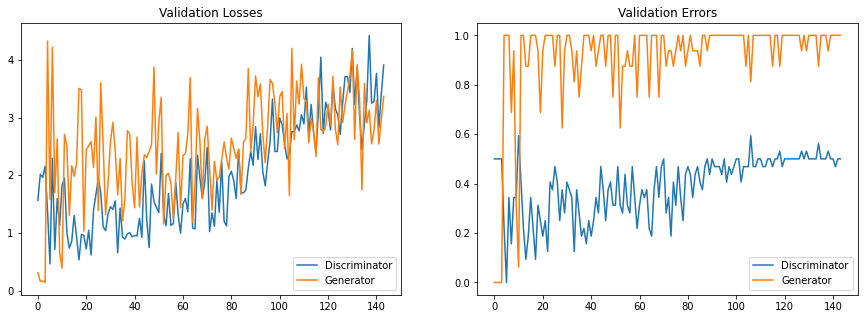

  0%|          | 0/55 [00:00<?, ?it/s]/tensorflow-1.15.2/python3.7/keras/engine/training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'
100%|██████████| 55/55 [00:05<00:00, 10.40it/s]


Epoch:  45/100 Discriminator Loss: 3.4444 Generator Loss: 3.5374


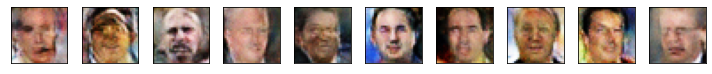

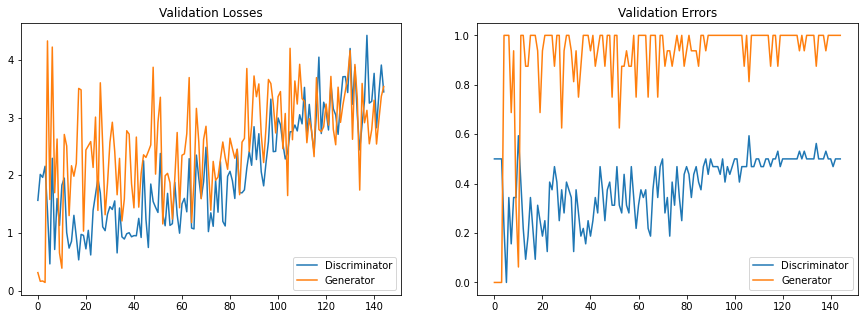

  0%|          | 0/55 [00:00<?, ?it/s]/tensorflow-1.15.2/python3.7/keras/engine/training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'
100%|██████████| 55/55 [00:04<00:00, 11.27it/s]


Epoch:  46/100 Discriminator Loss: 4.0216 Generator Loss: 2.6995


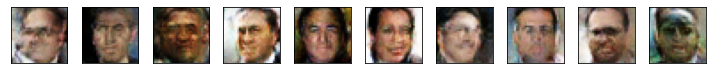

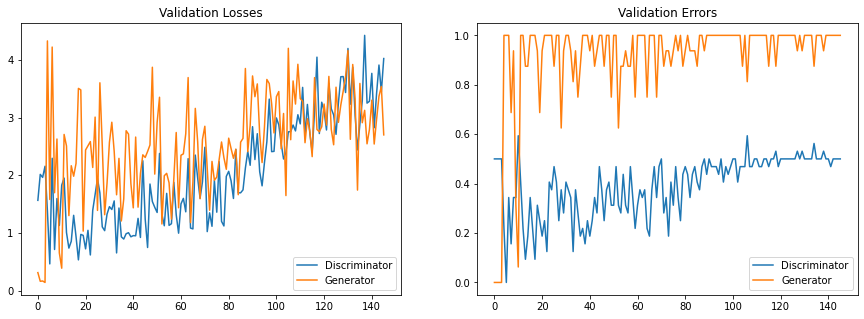

  0%|          | 0/55 [00:00<?, ?it/s]/tensorflow-1.15.2/python3.7/keras/engine/training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'
100%|██████████| 55/55 [00:05<00:00, 10.04it/s]


Epoch:  47/100 Discriminator Loss: 5.6182 Generator Loss: 4.0419


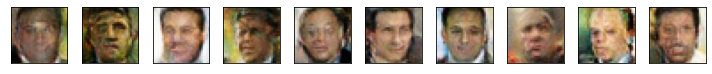

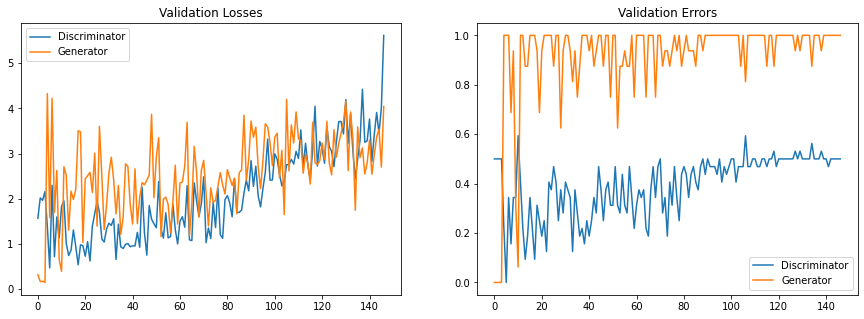

  0%|          | 0/55 [00:00<?, ?it/s]/tensorflow-1.15.2/python3.7/keras/engine/training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'
100%|██████████| 55/55 [00:05<00:00,  9.24it/s]


Epoch:  48/100 Discriminator Loss: 3.4058 Generator Loss: 2.5810


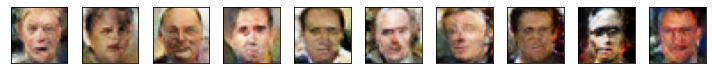

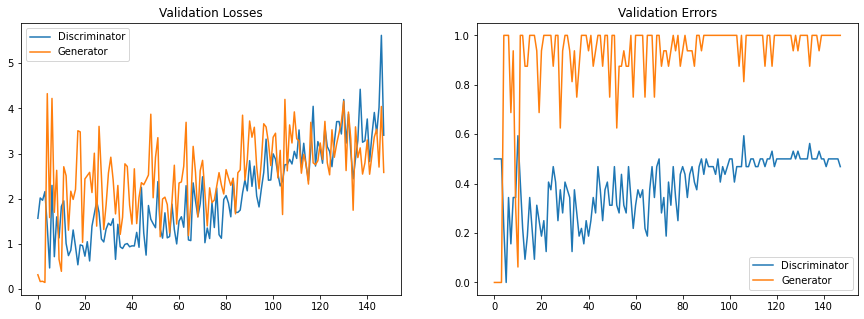

  0%|          | 0/55 [00:00<?, ?it/s]/tensorflow-1.15.2/python3.7/keras/engine/training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'
100%|██████████| 55/55 [00:05<00:00,  9.66it/s]


Epoch:  49/100 Discriminator Loss: 3.3263 Generator Loss: 1.8616


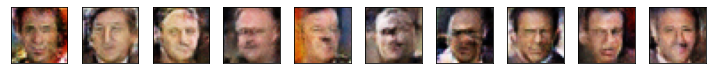

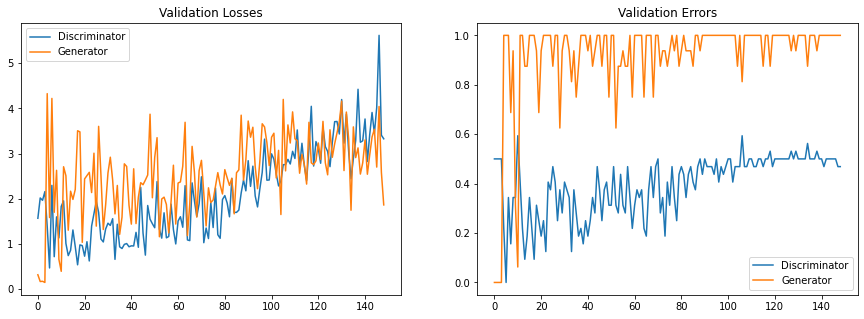

  0%|          | 0/55 [00:00<?, ?it/s]/tensorflow-1.15.2/python3.7/keras/engine/training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'
100%|██████████| 55/55 [00:04<00:00, 11.25it/s]


Epoch:  50/100 Discriminator Loss: 4.8365 Generator Loss: 4.6237


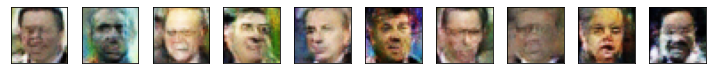

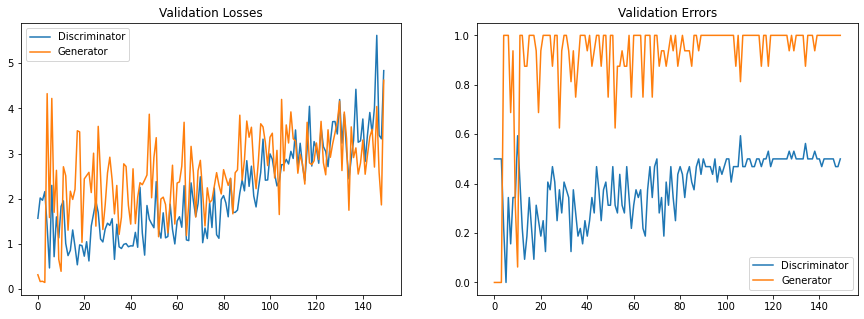

  0%|          | 0/55 [00:00<?, ?it/s]/tensorflow-1.15.2/python3.7/keras/engine/training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'
100%|██████████| 55/55 [00:04<00:00, 11.12it/s]


Epoch:  51/100 Discriminator Loss: 3.8198 Generator Loss: 2.5432


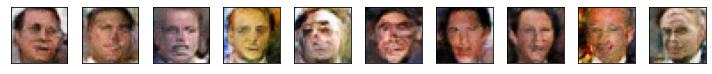

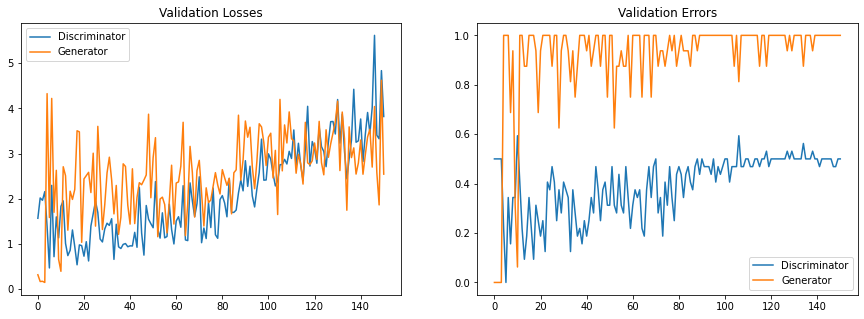

  0%|          | 0/55 [00:00<?, ?it/s]/tensorflow-1.15.2/python3.7/keras/engine/training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'
100%|██████████| 55/55 [00:05<00:00,  9.49it/s]


Epoch:  52/100 Discriminator Loss: 4.3462 Generator Loss: 4.4330


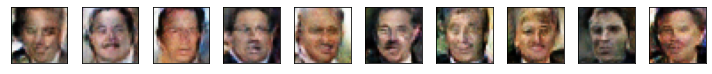

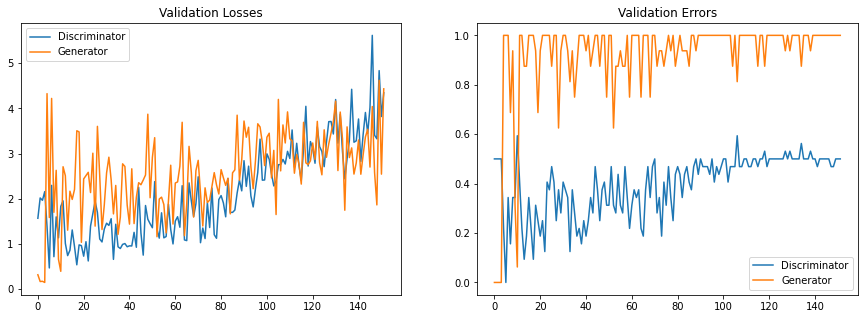

  0%|          | 0/55 [00:00<?, ?it/s]/tensorflow-1.15.2/python3.7/keras/engine/training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'
100%|██████████| 55/55 [00:05<00:00,  9.64it/s]


Epoch:  53/100 Discriminator Loss: 3.5823 Generator Loss: 3.8784


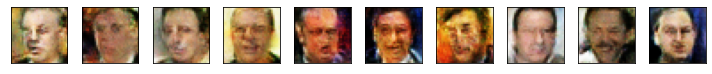

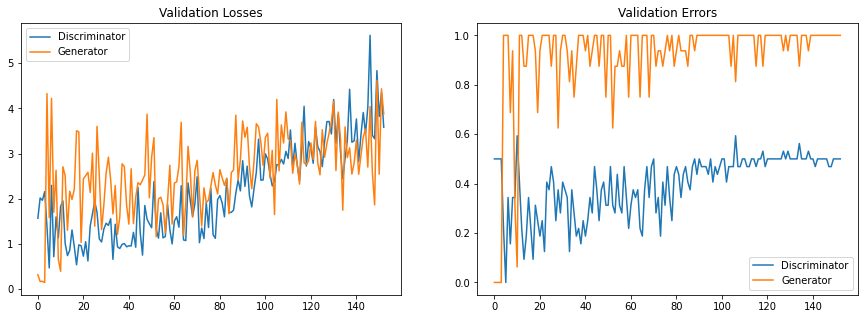

  0%|          | 0/55 [00:00<?, ?it/s]/tensorflow-1.15.2/python3.7/keras/engine/training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'
100%|██████████| 55/55 [00:05<00:00, 10.72it/s]


Epoch:  54/100 Discriminator Loss: 4.2498 Generator Loss: 3.9019


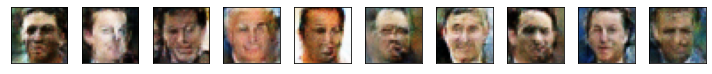

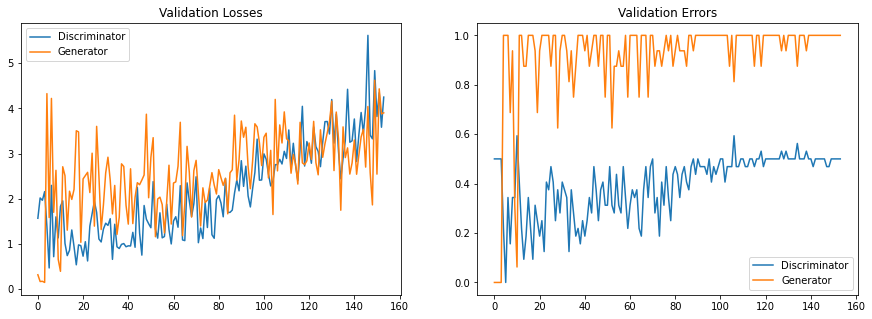

  0%|          | 0/55 [00:00<?, ?it/s]/tensorflow-1.15.2/python3.7/keras/engine/training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'
100%|██████████| 55/55 [00:05<00:00, 10.61it/s]


Epoch:  55/100 Discriminator Loss: 4.6462 Generator Loss: 3.1534


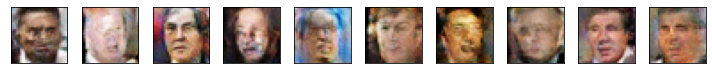

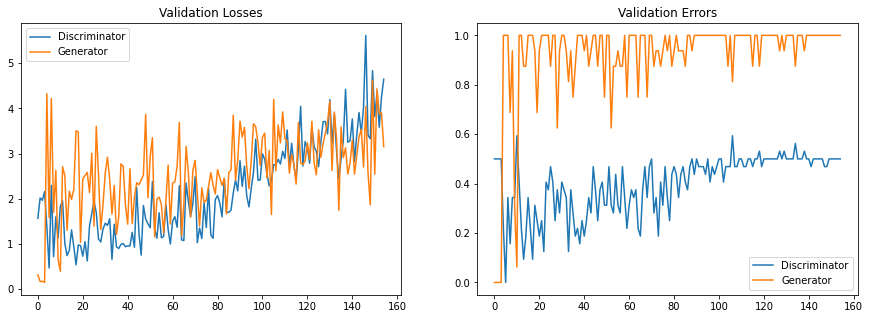

  0%|          | 0/55 [00:00<?, ?it/s]/tensorflow-1.15.2/python3.7/keras/engine/training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'
100%|██████████| 55/55 [00:05<00:00,  9.64it/s]


Epoch:  56/100 Discriminator Loss: 3.4515 Generator Loss: 2.3716


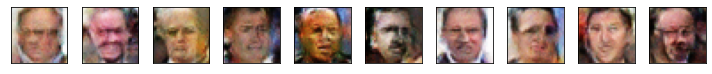

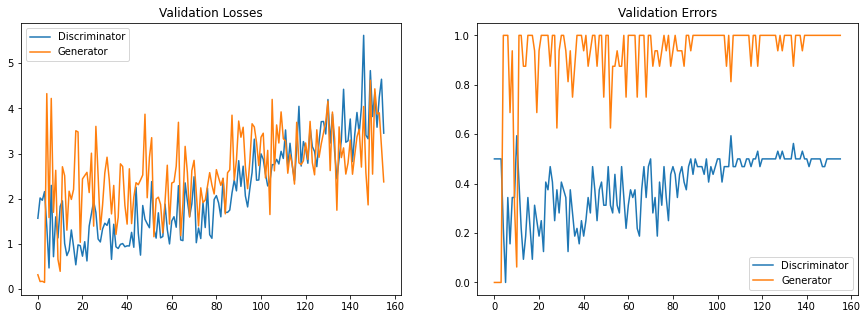

  0%|          | 0/55 [00:00<?, ?it/s]/tensorflow-1.15.2/python3.7/keras/engine/training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'
100%|██████████| 55/55 [00:05<00:00,  9.64it/s]


Epoch:  57/100 Discriminator Loss: 5.2143 Generator Loss: 3.8194


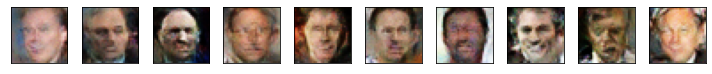

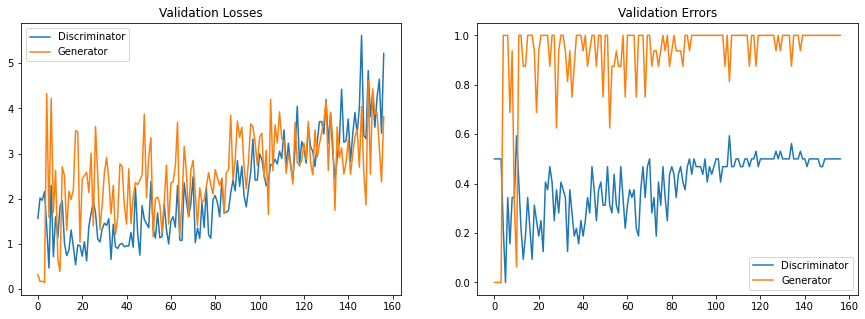

  0%|          | 0/55 [00:00<?, ?it/s]/tensorflow-1.15.2/python3.7/keras/engine/training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'
100%|██████████| 55/55 [00:05<00:00,  9.70it/s]


Epoch:  58/100 Discriminator Loss: 3.4486 Generator Loss: 3.9619


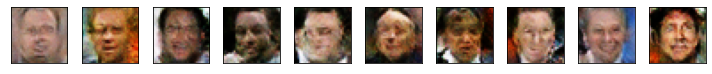

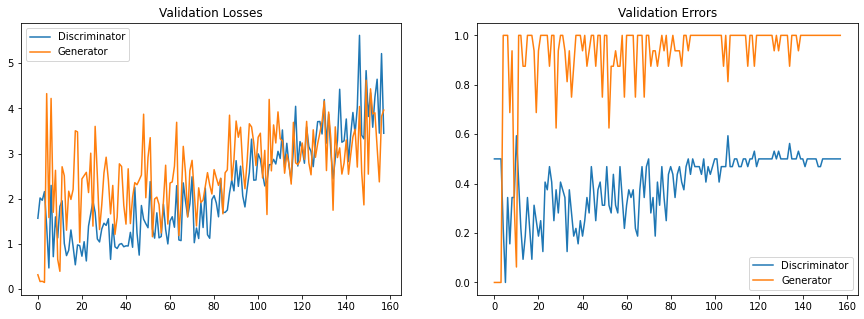

  0%|          | 0/55 [00:00<?, ?it/s]/tensorflow-1.15.2/python3.7/keras/engine/training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'
100%|██████████| 55/55 [00:05<00:00,  9.60it/s]


Epoch:  59/100 Discriminator Loss: 4.0598 Generator Loss: 3.1762


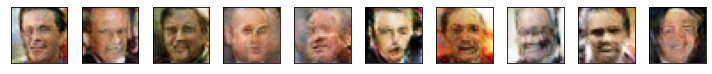

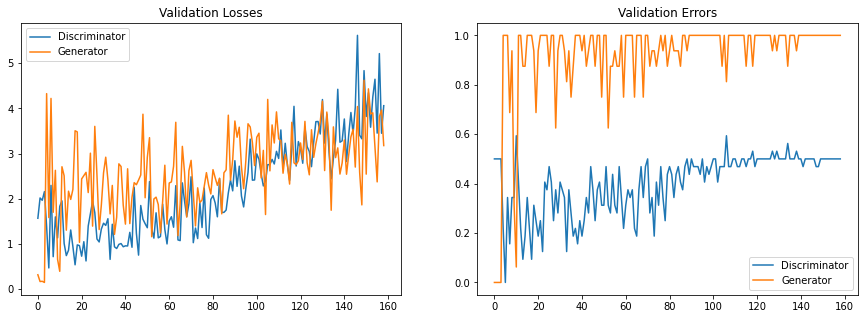

  0%|          | 0/55 [00:00<?, ?it/s]/tensorflow-1.15.2/python3.7/keras/engine/training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'
100%|██████████| 55/55 [00:05<00:00,  9.61it/s]


Epoch:  60/100 Discriminator Loss: 3.7759 Generator Loss: 3.0356


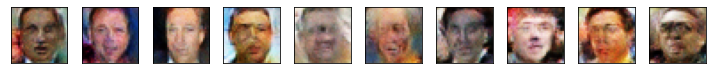

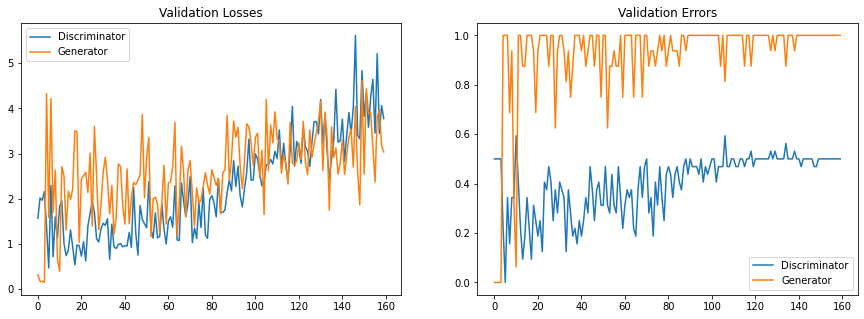

  0%|          | 0/55 [00:00<?, ?it/s]/tensorflow-1.15.2/python3.7/keras/engine/training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'
100%|██████████| 55/55 [00:05<00:00,  9.45it/s]


Epoch:  61/100 Discriminator Loss: 3.9583 Generator Loss: 3.3372


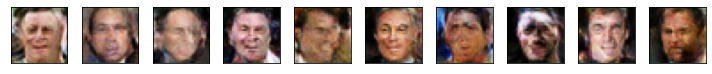

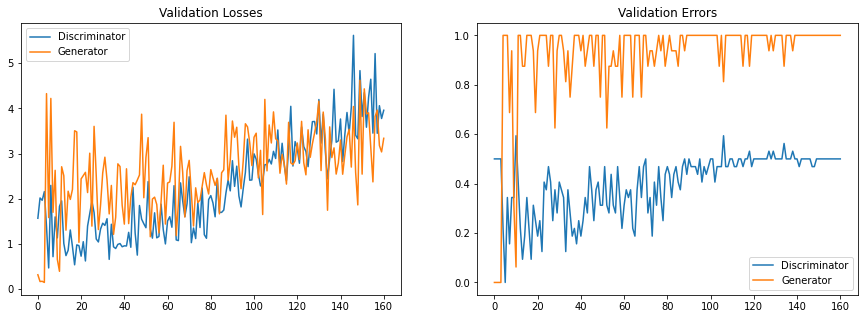

  0%|          | 0/55 [00:00<?, ?it/s]/tensorflow-1.15.2/python3.7/keras/engine/training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'
100%|██████████| 55/55 [00:05<00:00,  9.69it/s]


Epoch:  62/100 Discriminator Loss: 4.2898 Generator Loss: 2.2100


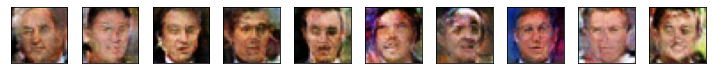

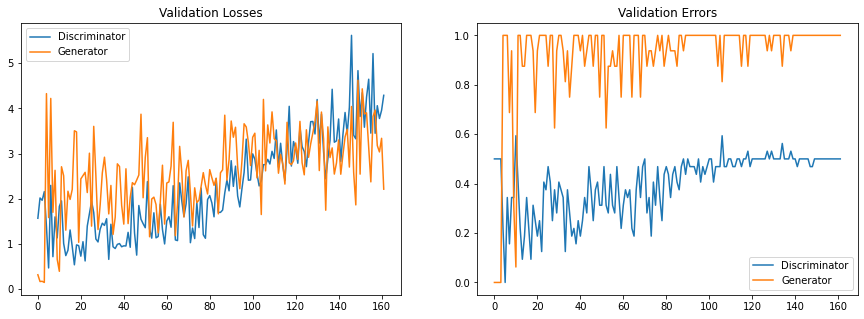

  0%|          | 0/55 [00:00<?, ?it/s]/tensorflow-1.15.2/python3.7/keras/engine/training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'
100%|██████████| 55/55 [00:05<00:00,  9.85it/s]


Epoch:  63/100 Discriminator Loss: 3.8795 Generator Loss: 3.0033


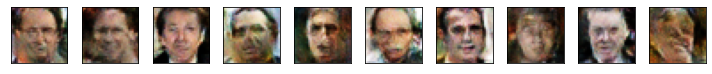

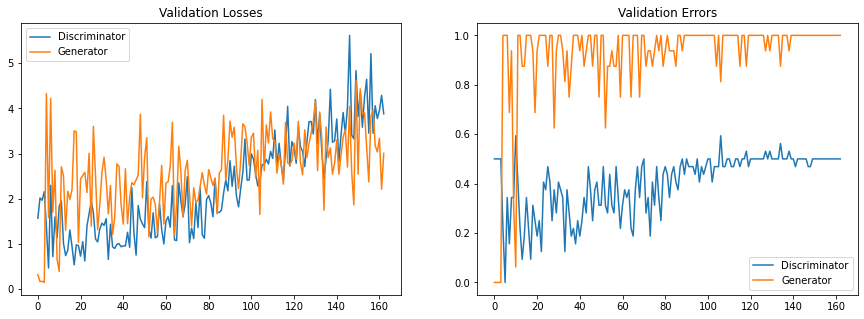

  0%|          | 0/55 [00:00<?, ?it/s]/tensorflow-1.15.2/python3.7/keras/engine/training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'
100%|██████████| 55/55 [00:05<00:00,  9.68it/s]


Epoch:  64/100 Discriminator Loss: 3.8985 Generator Loss: 2.7345


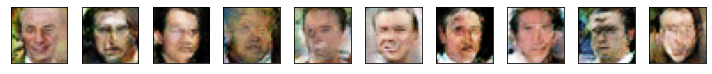

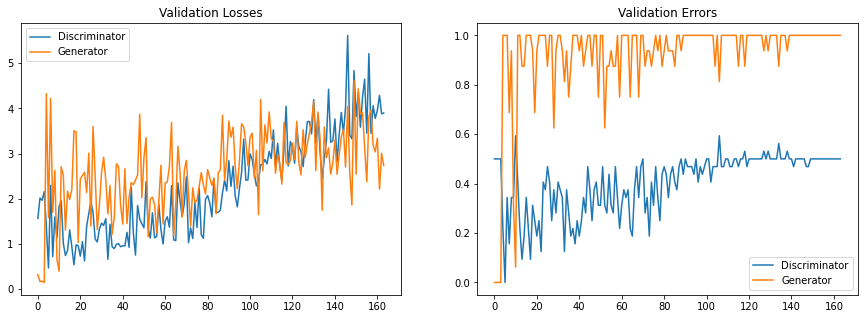

  0%|          | 0/55 [00:00<?, ?it/s]/tensorflow-1.15.2/python3.7/keras/engine/training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'
100%|██████████| 55/55 [00:05<00:00,  9.58it/s]


Epoch:  65/100 Discriminator Loss: 5.4860 Generator Loss: 3.7363


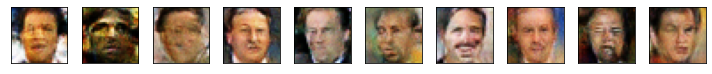

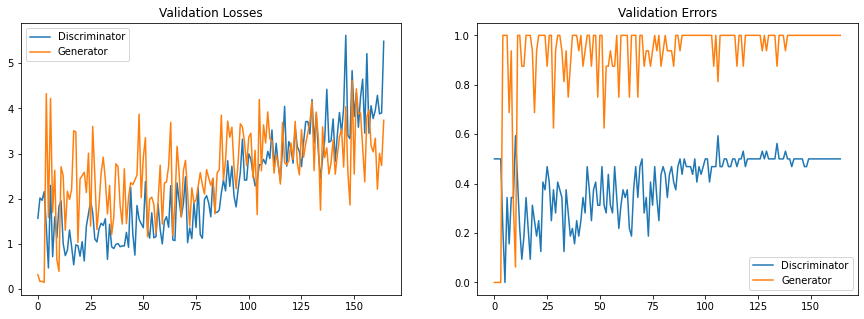

  0%|          | 0/55 [00:00<?, ?it/s]/tensorflow-1.15.2/python3.7/keras/engine/training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'
100%|██████████| 55/55 [00:05<00:00,  9.65it/s]


Epoch:  66/100 Discriminator Loss: 4.7785 Generator Loss: 2.8405


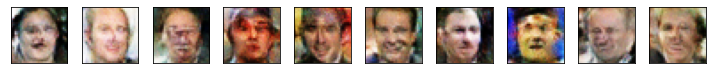

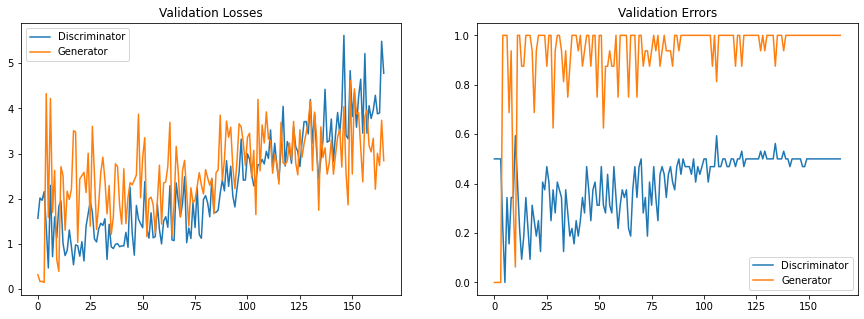

  0%|          | 0/55 [00:00<?, ?it/s]/tensorflow-1.15.2/python3.7/keras/engine/training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'
100%|██████████| 55/55 [00:05<00:00,  9.60it/s]


Epoch:  67/100 Discriminator Loss: 3.8194 Generator Loss: 4.3226


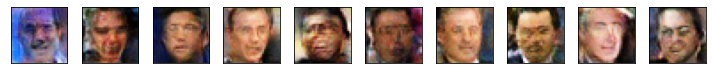

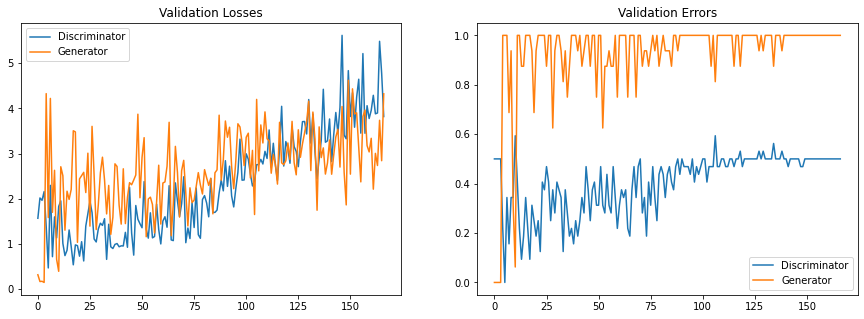

  0%|          | 0/55 [00:00<?, ?it/s]/tensorflow-1.15.2/python3.7/keras/engine/training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'
100%|██████████| 55/55 [00:05<00:00,  9.61it/s]


Epoch:  68/100 Discriminator Loss: 4.6649 Generator Loss: 3.0357


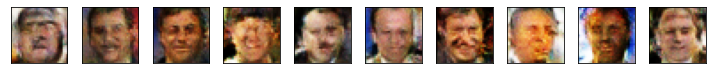

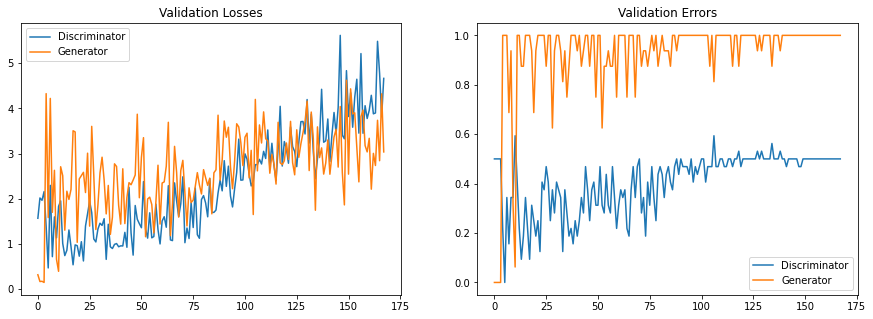

  0%|          | 0/55 [00:00<?, ?it/s]/tensorflow-1.15.2/python3.7/keras/engine/training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'
100%|██████████| 55/55 [00:05<00:00,  9.52it/s]


Epoch:  69/100 Discriminator Loss: 4.4069 Generator Loss: 2.9860


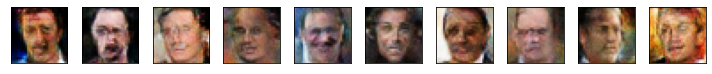

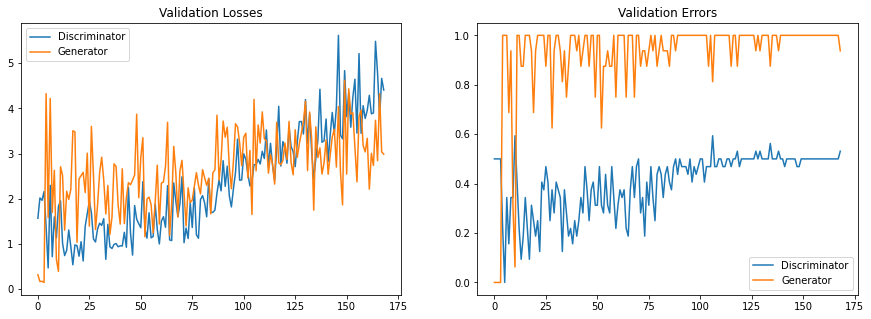

  0%|          | 0/55 [00:00<?, ?it/s]/tensorflow-1.15.2/python3.7/keras/engine/training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'
100%|██████████| 55/55 [00:05<00:00,  9.59it/s]


Epoch:  70/100 Discriminator Loss: 5.1095 Generator Loss: 3.4679


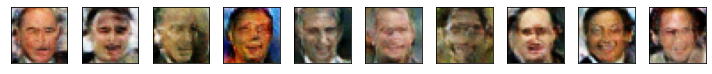

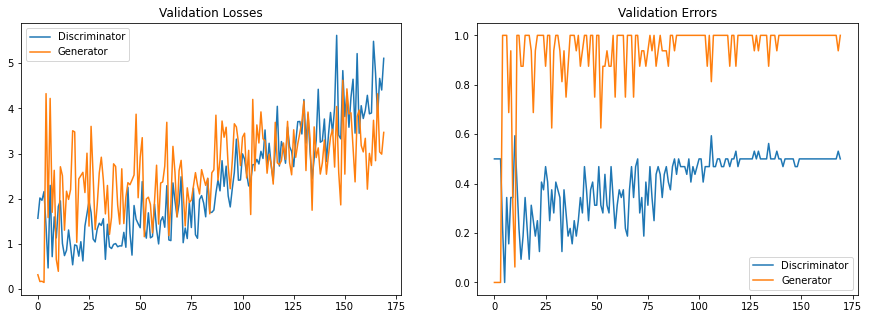

  0%|          | 0/55 [00:00<?, ?it/s]/tensorflow-1.15.2/python3.7/keras/engine/training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'
100%|██████████| 55/55 [00:05<00:00,  9.58it/s]


Epoch:  71/100 Discriminator Loss: 5.1602 Generator Loss: 4.2541


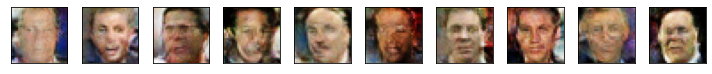

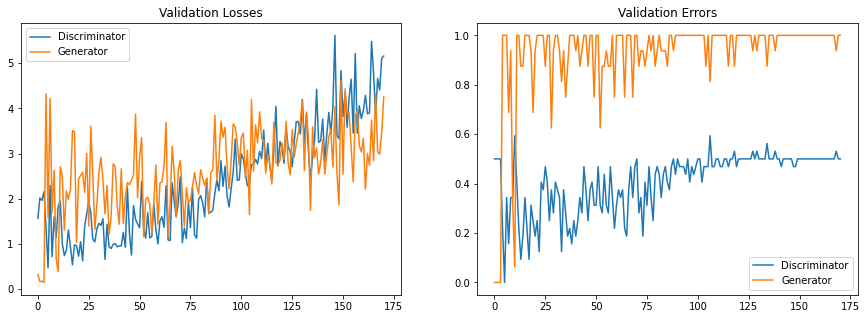

  0%|          | 0/55 [00:00<?, ?it/s]/tensorflow-1.15.2/python3.7/keras/engine/training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'
100%|██████████| 55/55 [00:05<00:00,  9.61it/s]


Epoch:  72/100 Discriminator Loss: 3.8647 Generator Loss: 2.7927


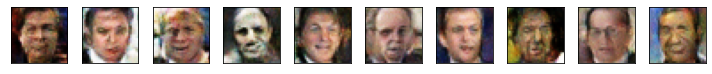

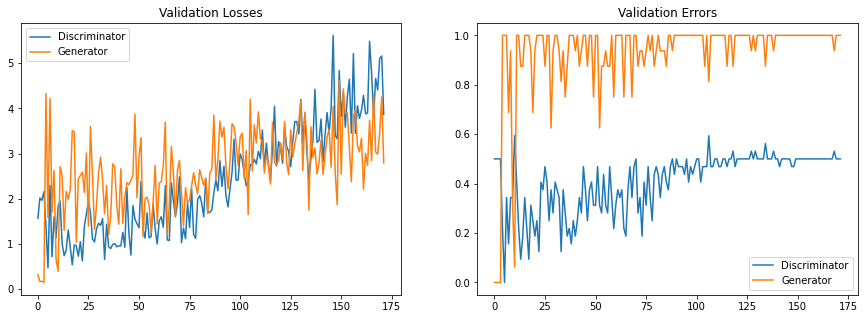

  0%|          | 0/55 [00:00<?, ?it/s]/tensorflow-1.15.2/python3.7/keras/engine/training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'
100%|██████████| 55/55 [00:05<00:00,  9.48it/s]


Epoch:  73/100 Discriminator Loss: 5.5677 Generator Loss: 3.0633


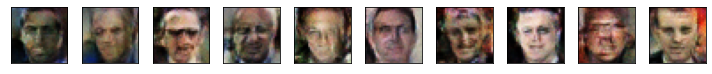

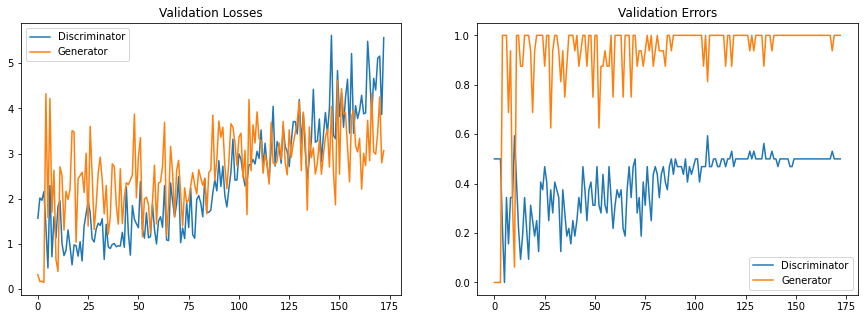

  0%|          | 0/55 [00:00<?, ?it/s]/tensorflow-1.15.2/python3.7/keras/engine/training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'
100%|██████████| 55/55 [00:05<00:00,  9.58it/s]


Epoch:  74/100 Discriminator Loss: 5.3668 Generator Loss: 4.0525


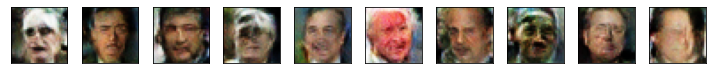

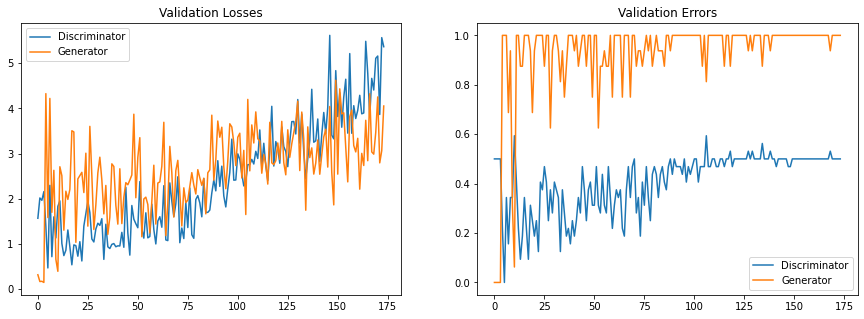

  0%|          | 0/55 [00:00<?, ?it/s]/tensorflow-1.15.2/python3.7/keras/engine/training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'
100%|██████████| 55/55 [00:05<00:00,  9.49it/s]


Epoch:  75/100 Discriminator Loss: 2.5731 Generator Loss: 2.2087


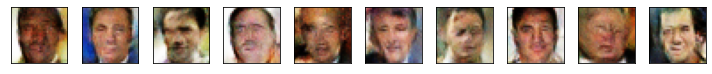

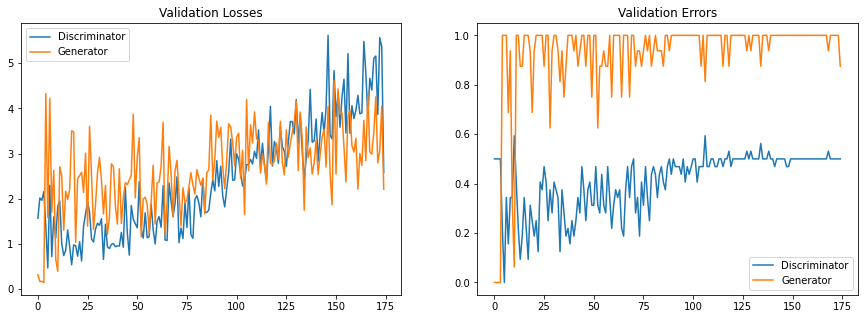

  0%|          | 0/55 [00:00<?, ?it/s]/tensorflow-1.15.2/python3.7/keras/engine/training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'
100%|██████████| 55/55 [00:05<00:00,  9.54it/s]


Epoch:  76/100 Discriminator Loss: 3.8695 Generator Loss: 4.3895


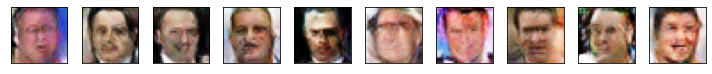

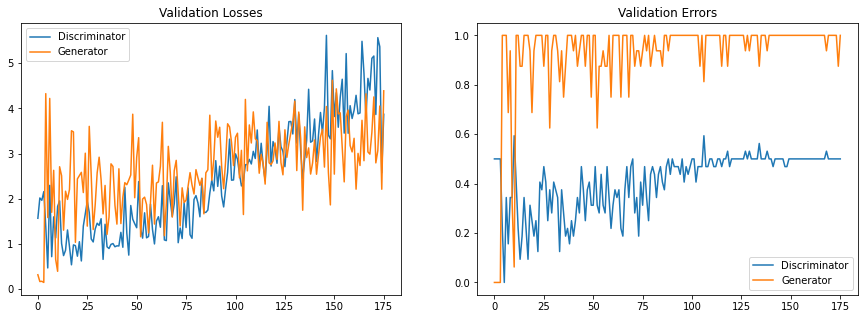

  0%|          | 0/55 [00:00<?, ?it/s]/tensorflow-1.15.2/python3.7/keras/engine/training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'
100%|██████████| 55/55 [00:05<00:00,  9.63it/s]


Epoch:  77/100 Discriminator Loss: 4.3679 Generator Loss: 3.6083


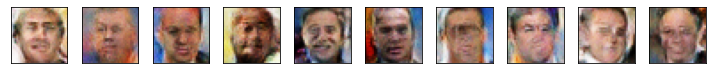

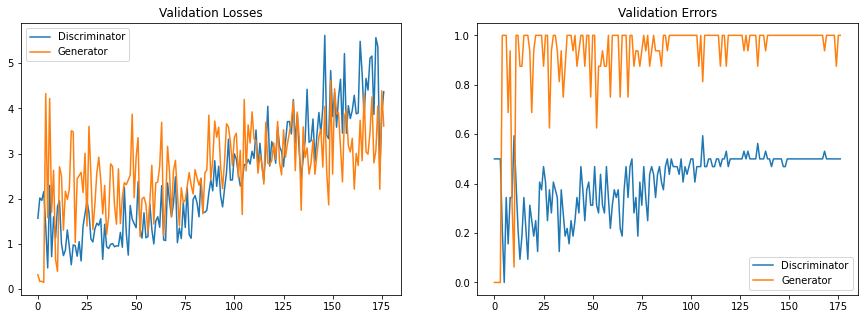

  0%|          | 0/55 [00:00<?, ?it/s]/tensorflow-1.15.2/python3.7/keras/engine/training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'
100%|██████████| 55/55 [00:06<00:00,  8.69it/s]


Epoch:  78/100 Discriminator Loss: 5.0927 Generator Loss: 3.6947


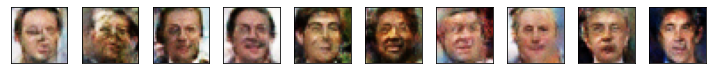

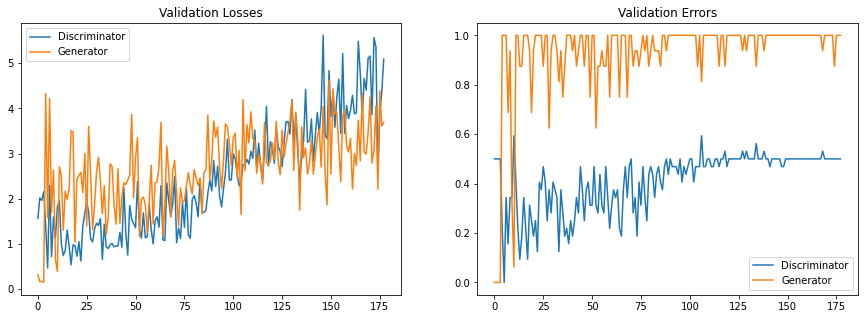

  0%|          | 0/55 [00:00<?, ?it/s]/tensorflow-1.15.2/python3.7/keras/engine/training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'
100%|██████████| 55/55 [00:05<00:00,  9.61it/s]


Epoch:  79/100 Discriminator Loss: 5.1039 Generator Loss: 3.3967


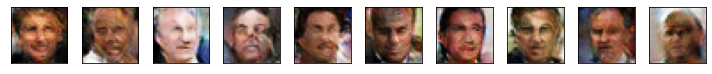

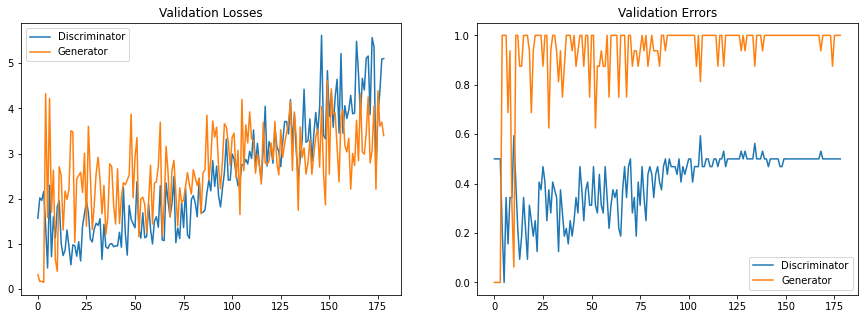

  0%|          | 0/55 [00:00<?, ?it/s]/tensorflow-1.15.2/python3.7/keras/engine/training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'
100%|██████████| 55/55 [00:05<00:00,  9.58it/s]


Epoch:  80/100 Discriminator Loss: 5.1510 Generator Loss: 4.0451


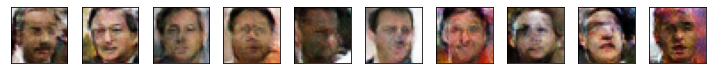

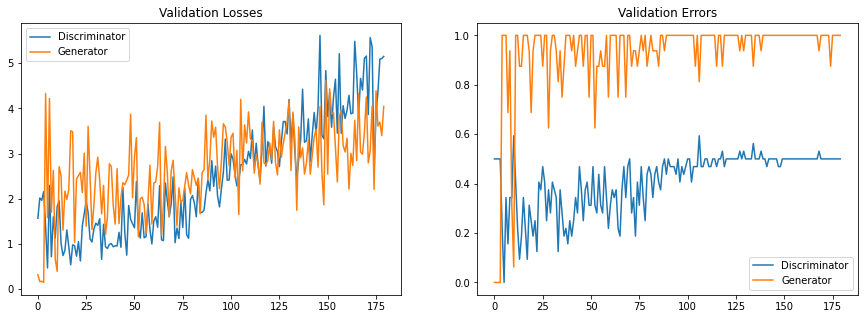

  0%|          | 0/55 [00:00<?, ?it/s]/tensorflow-1.15.2/python3.7/keras/engine/training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'
100%|██████████| 55/55 [00:05<00:00,  9.44it/s]


Epoch:  81/100 Discriminator Loss: 4.4108 Generator Loss: 3.1108


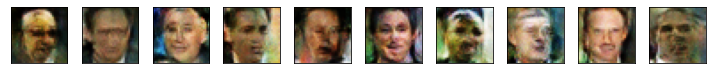

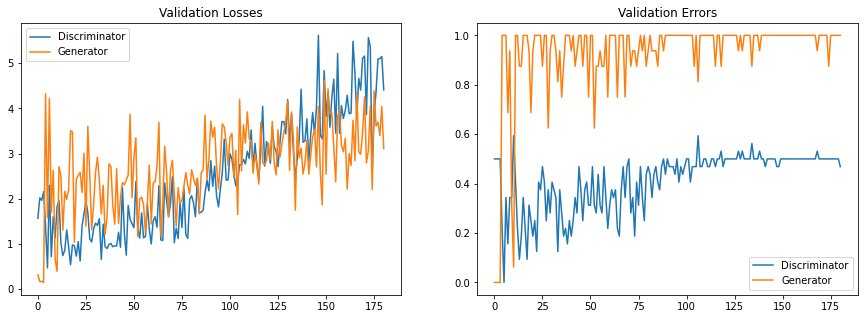

  0%|          | 0/55 [00:00<?, ?it/s]/tensorflow-1.15.2/python3.7/keras/engine/training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'
100%|██████████| 55/55 [00:05<00:00,  9.45it/s]


Epoch:  82/100 Discriminator Loss: 3.9841 Generator Loss: 2.8204


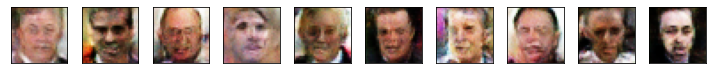

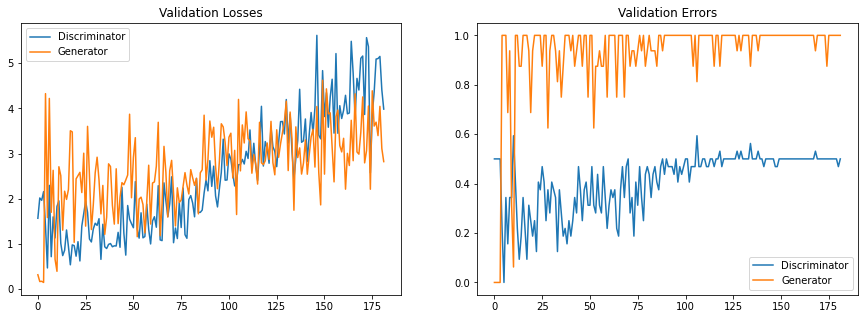

  0%|          | 0/55 [00:00<?, ?it/s]/tensorflow-1.15.2/python3.7/keras/engine/training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'
100%|██████████| 55/55 [00:05<00:00,  9.69it/s]


Epoch:  83/100 Discriminator Loss: 4.0214 Generator Loss: 3.1567


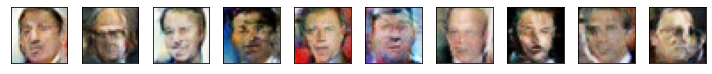

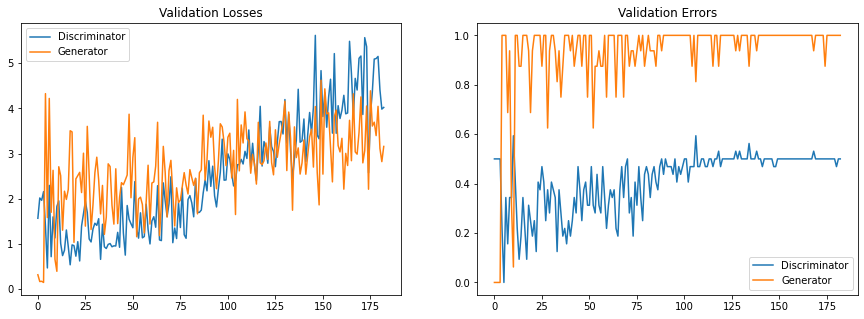

  0%|          | 0/55 [00:00<?, ?it/s]/tensorflow-1.15.2/python3.7/keras/engine/training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'
100%|██████████| 55/55 [00:05<00:00,  9.62it/s]


Epoch:  84/100 Discriminator Loss: 4.3966 Generator Loss: 3.6501


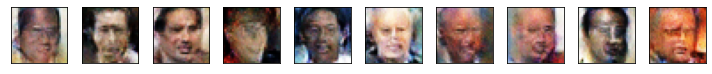

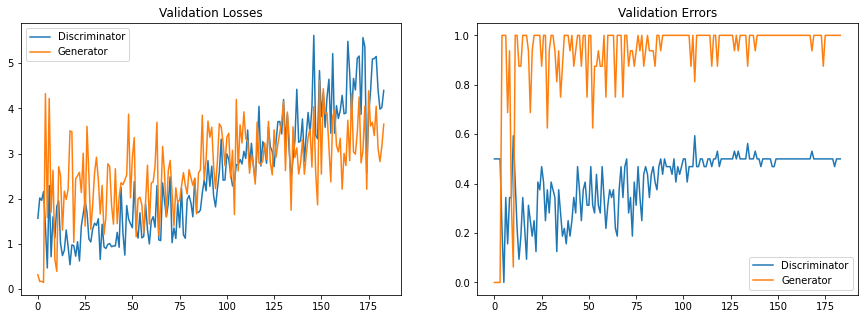

  0%|          | 0/55 [00:00<?, ?it/s]/tensorflow-1.15.2/python3.7/keras/engine/training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'
100%|██████████| 55/55 [00:05<00:00,  9.68it/s]


Epoch:  85/100 Discriminator Loss: 3.5935 Generator Loss: 2.6706


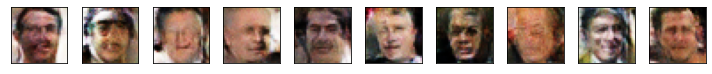

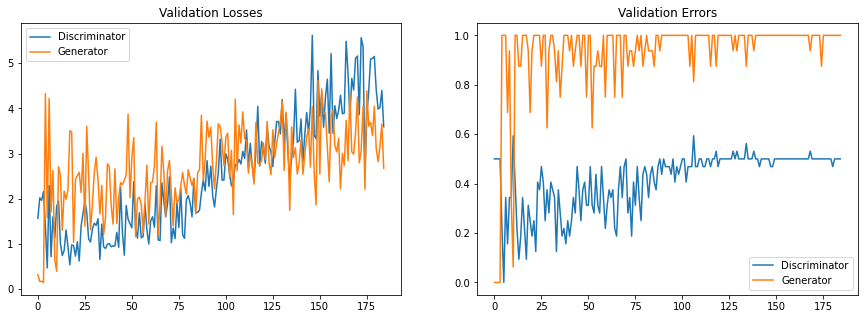

  0%|          | 0/55 [00:00<?, ?it/s]/tensorflow-1.15.2/python3.7/keras/engine/training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'
100%|██████████| 55/55 [00:05<00:00,  9.67it/s]


Epoch:  86/100 Discriminator Loss: 3.3059 Generator Loss: 1.5828


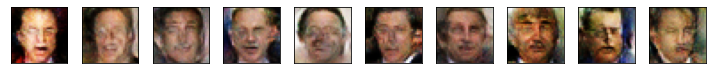

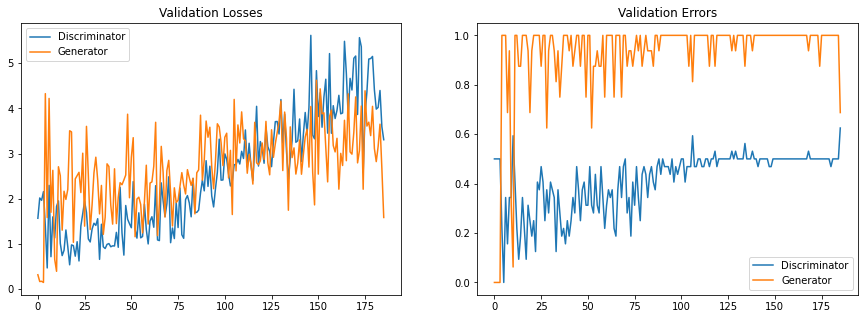

  0%|          | 0/55 [00:00<?, ?it/s]/tensorflow-1.15.2/python3.7/keras/engine/training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'
100%|██████████| 55/55 [00:05<00:00,  9.58it/s]


Epoch:  87/100 Discriminator Loss: 5.2893 Generator Loss: 4.7173


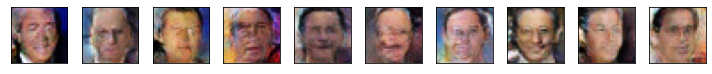

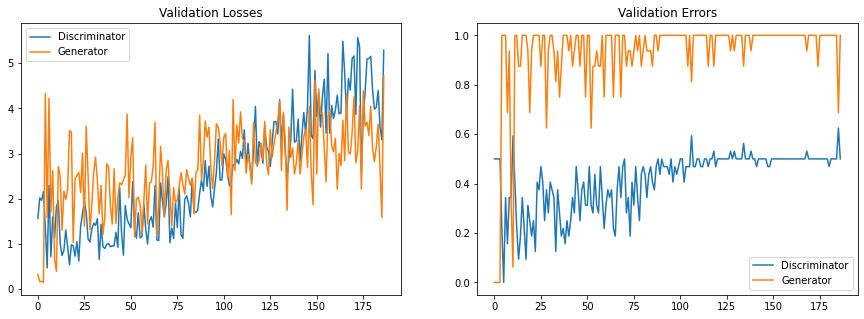

  0%|          | 0/55 [00:00<?, ?it/s]/tensorflow-1.15.2/python3.7/keras/engine/training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'
100%|██████████| 55/55 [00:05<00:00,  9.60it/s]


Epoch:  88/100 Discriminator Loss: 4.1164 Generator Loss: 3.0547


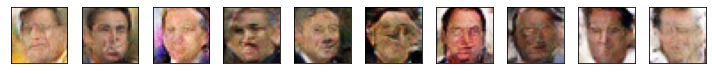

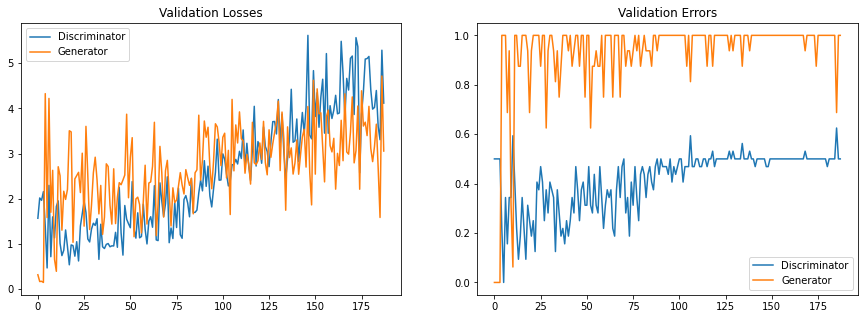

  0%|          | 0/55 [00:00<?, ?it/s]/tensorflow-1.15.2/python3.7/keras/engine/training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'
100%|██████████| 55/55 [00:05<00:00,  9.58it/s]


Epoch:  89/100 Discriminator Loss: 2.9016 Generator Loss: 2.7723


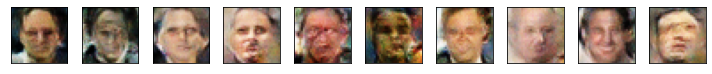

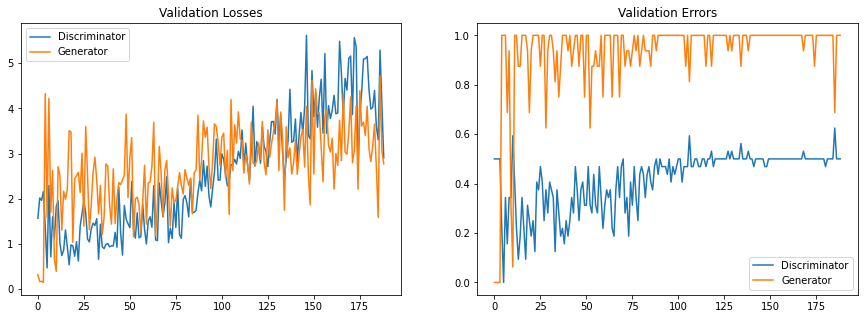

  0%|          | 0/55 [00:00<?, ?it/s]/tensorflow-1.15.2/python3.7/keras/engine/training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'
100%|██████████| 55/55 [00:05<00:00,  9.56it/s]


Epoch:  90/100 Discriminator Loss: 5.8192 Generator Loss: 4.4280


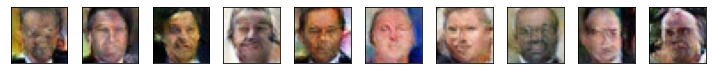

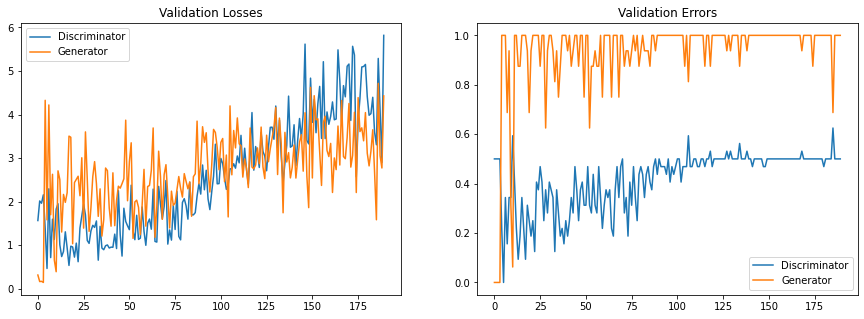

  0%|          | 0/55 [00:00<?, ?it/s]/tensorflow-1.15.2/python3.7/keras/engine/training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'
100%|██████████| 55/55 [00:05<00:00,  9.73it/s]


Epoch:  91/100 Discriminator Loss: 4.9006 Generator Loss: 3.9190


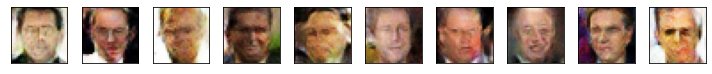

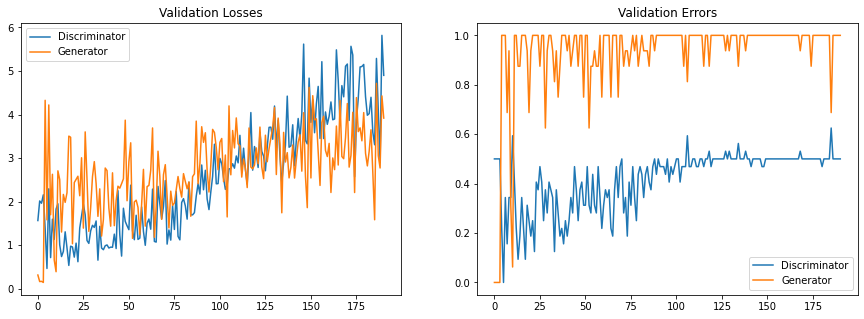

  0%|          | 0/55 [00:00<?, ?it/s]/tensorflow-1.15.2/python3.7/keras/engine/training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'
100%|██████████| 55/55 [00:05<00:00,  9.52it/s]


Epoch:  92/100 Discriminator Loss: 4.5780 Generator Loss: 3.5868


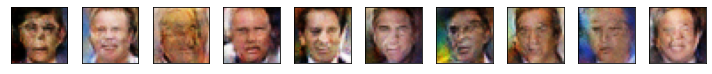

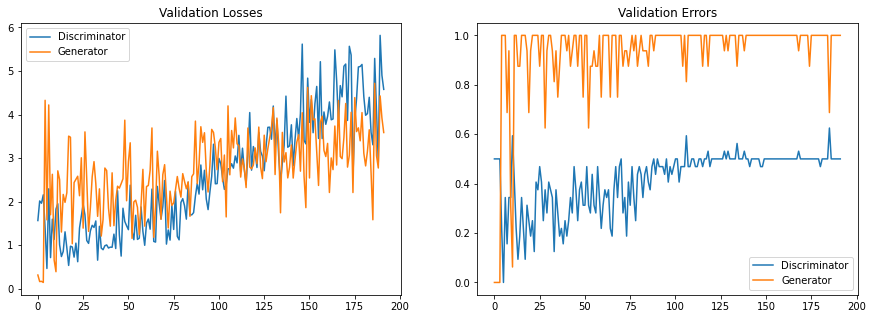

  0%|          | 0/55 [00:00<?, ?it/s]/tensorflow-1.15.2/python3.7/keras/engine/training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'
100%|██████████| 55/55 [00:05<00:00,  9.69it/s]


Epoch:  93/100 Discriminator Loss: 4.3086 Generator Loss: 3.9289


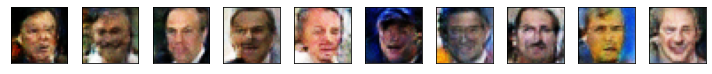

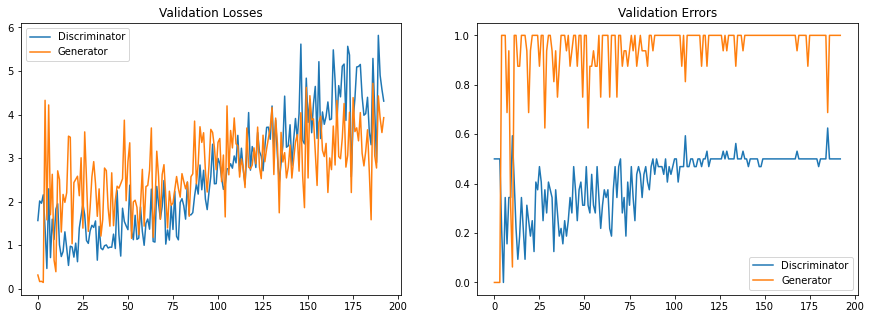

  0%|          | 0/55 [00:00<?, ?it/s]/tensorflow-1.15.2/python3.7/keras/engine/training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'
100%|██████████| 55/55 [00:05<00:00,  9.61it/s]


Epoch:  94/100 Discriminator Loss: 3.8223 Generator Loss: 3.4315


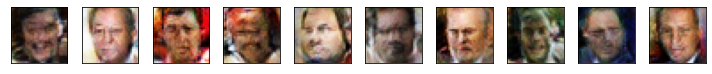

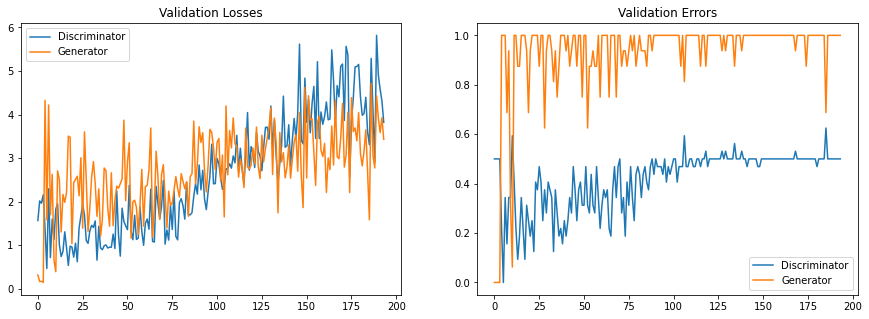

  0%|          | 0/55 [00:00<?, ?it/s]/tensorflow-1.15.2/python3.7/keras/engine/training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'
100%|██████████| 55/55 [00:05<00:00,  9.60it/s]


Epoch:  95/100 Discriminator Loss: 5.2112 Generator Loss: 3.1199


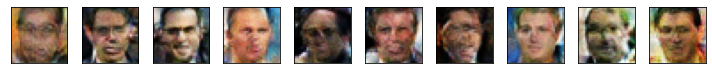

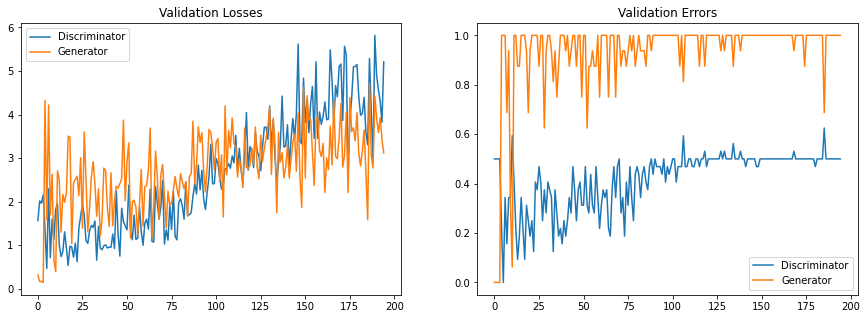

  0%|          | 0/55 [00:00<?, ?it/s]/tensorflow-1.15.2/python3.7/keras/engine/training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'
100%|██████████| 55/55 [00:05<00:00,  9.57it/s]


Epoch:  96/100 Discriminator Loss: 4.9425 Generator Loss: 3.2998


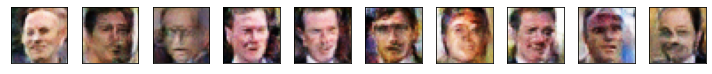

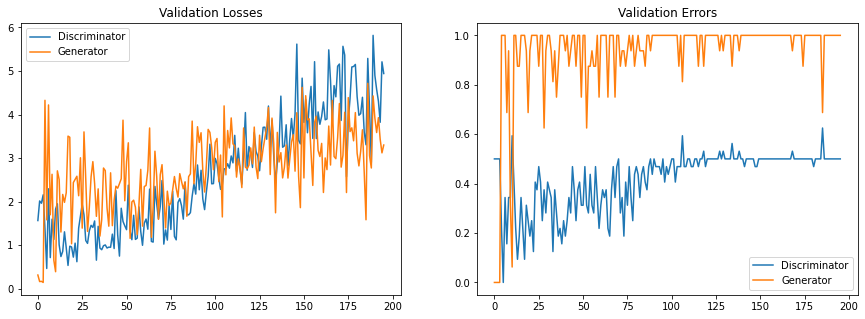

  0%|          | 0/55 [00:00<?, ?it/s]/tensorflow-1.15.2/python3.7/keras/engine/training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'
100%|██████████| 55/55 [00:05<00:00,  9.76it/s]


Epoch:  97/100 Discriminator Loss: 4.5934 Generator Loss: 3.2327


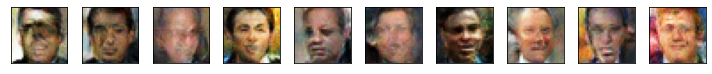

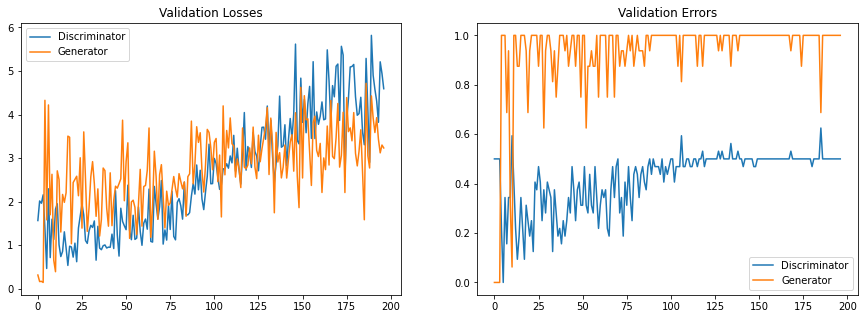

  0%|          | 0/55 [00:00<?, ?it/s]/tensorflow-1.15.2/python3.7/keras/engine/training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'
100%|██████████| 55/55 [00:05<00:00,  9.49it/s]


Epoch:  98/100 Discriminator Loss: 6.3150 Generator Loss: 3.6928


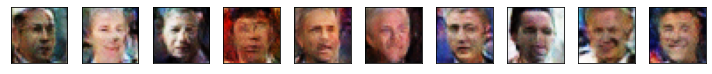

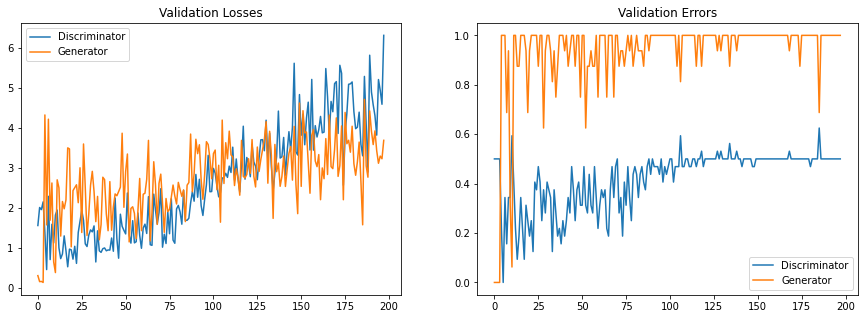

  0%|          | 0/55 [00:00<?, ?it/s]/tensorflow-1.15.2/python3.7/keras/engine/training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'
100%|██████████| 55/55 [00:05<00:00,  9.61it/s]


Epoch:  99/100 Discriminator Loss: 4.3312 Generator Loss: 2.7917


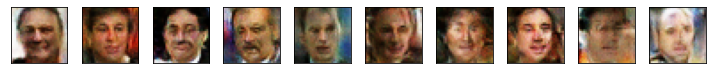

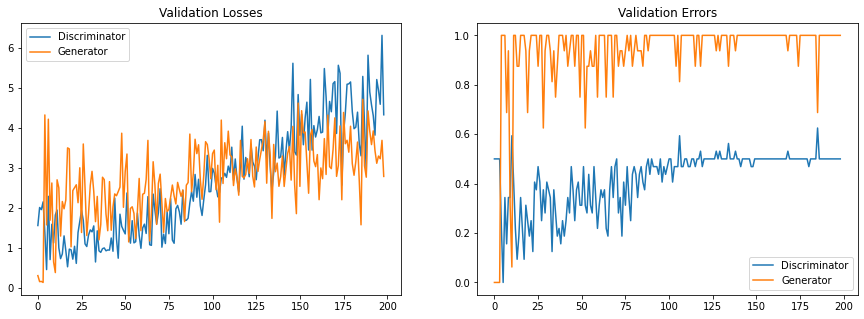

  0%|          | 0/55 [00:00<?, ?it/s]/tensorflow-1.15.2/python3.7/keras/engine/training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'
100%|██████████| 55/55 [00:05<00:00,  9.68it/s]


Epoch: 100/100 Discriminator Loss: 4.8104 Generator Loss: 3.1518


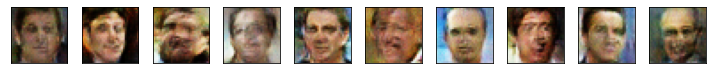

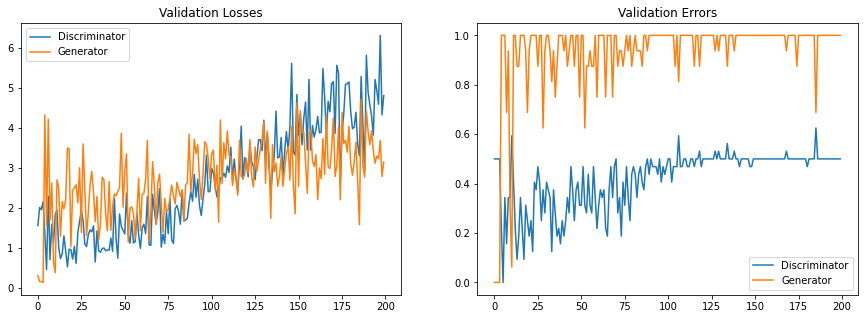

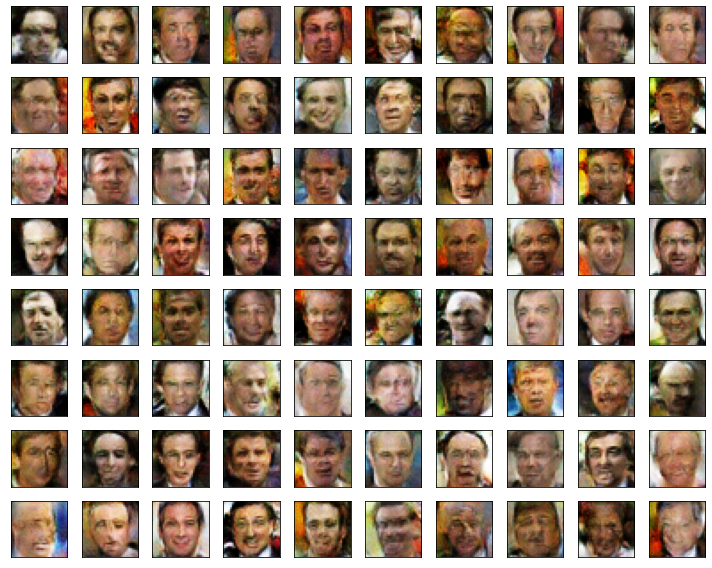

In [40]:
if TRAIN:
    for e in range(epochs):
        for i in tqdm(range(len(X_train)//batch_size)):
            # real CelebA images
            X_batch = X_train[i*batch_size:(i+1)*batch_size]
            X_batch_real = np.array([preprocess(load_image(filename)) for filename in X_batch])

             # latent samples and the generated digit images
            latent_samples = make_latent_samples(batch_size, sample_size)
            X_batch_fake = generator.predict_on_batch(latent_samples)

            # train the discriminator to detect real and fake images
            make_trainable(discriminator, True)        
            discriminator.train_on_batch(X_batch_real, y_train_real * (1 - smooth))
            discriminator.train_on_batch(X_batch_fake, y_train_fake)

            # train the generator via GAN
            make_trainable(discriminator, False)
            gan.train_on_batch(latent_samples, y_train_real)

        # evaluate
        X_eval = X_test[np.random.choice(len(X_test), eval_size, replace=False)]
        X_eval_real = np.array([preprocess(load_image(filename)) for filename in X_eval])

        latent_samples = make_latent_samples(eval_size, sample_size)
        X_eval_fake = generator.predict_on_batch(latent_samples)

        d_loss  = discriminator.test_on_batch(X_eval_real, y_eval_real)
        d_loss += discriminator.test_on_batch(X_eval_fake, y_eval_fake)
        g_loss  = gan.test_on_batch(latent_samples, y_eval_real) # we want the fake to be realistic!

        losses.append((d_loss, g_loss))

        d_error = 0
        preds = discriminator.predict(X_eval_real).flatten().round()
        d_error += sum(preds!=y_eval_real[0][0])
        preds = discriminator.predict(X_eval_fake).flatten().round()
        d_error += sum(preds!=y_eval_fake[0][0])
        d_error /= (len(X_eval_real) + len(X_eval_fake))
        g_error = np.mean(gan.predict(latent_samples).flatten().round() != y_eval_real[0][0])

        errors.append((d_error, g_error))

        print("Epoch: {:>3}/{} Discriminator Loss: {:>6.4f} Generator Loss: {:>6.4f}".format(
            e+1, epochs, d_loss, g_loss))    
        show_images(X_eval_fake[:10])
        show_losses_and_errors(losses, errors)

    # show the result
    #show_losses(losses)
else:
    if COLAB:
        gdd.download_file_from_google_drive(file_id='1BbK3dG1O4LWPXN3ZniOPARJOoNClvTA9',
                                            dest_path='./discriminator_weights_1.h5', overwrite=True)
        gdd.download_file_from_google_drive(file_id='1rGu8vYbR4HoPoRZVstNtHjHRZuqjE4Qj',
                                            dest_path='./generator_weights_1.h5', overwrite=True)
    discriminator.load_weights("discriminator_weights_1.h5")
    generator.load_weights("generator_weights_1.h5")

show_images(generator.predict(make_latent_samples(80, sample_size)))

In [41]:
#discriminator.save_weights("discriminator_weights_1.h5")
#generator.save_weights("generator_weights_1.h5")

In [42]:
sample_size

100

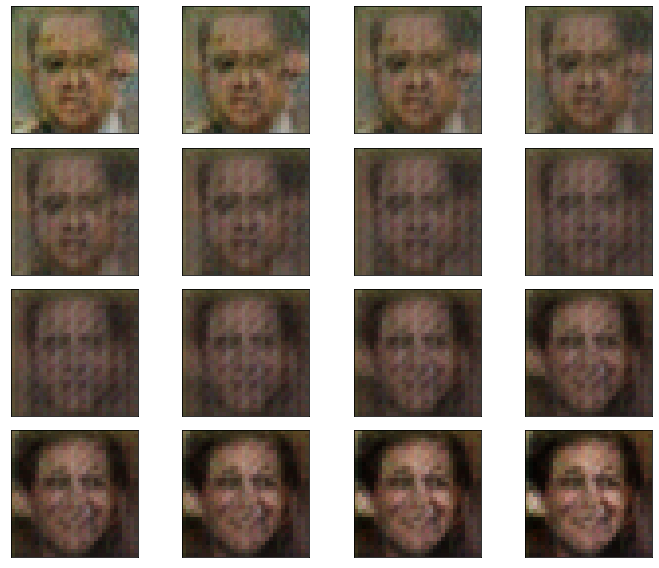

In [43]:
N = 16
aux = np.zeros((N,100))
for i in range(4,5): # 10,11
    aux[:,i] = np.linspace(-5,5,N)
show_images(generator.predict(aux), cols=4)

In [44]:
make_latent_samples(80, sample_size).shape

(80, 100)

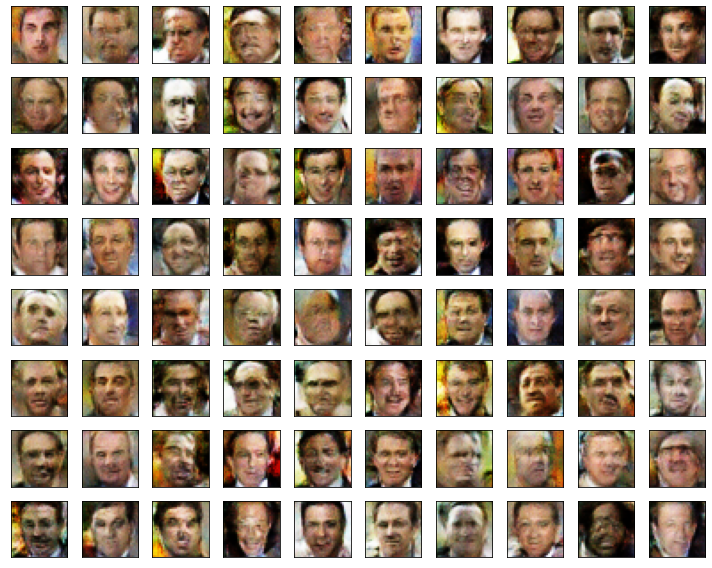

In [45]:
show_images(generator.predict(make_latent_samples(80, sample_size)))

In [37]:
generator.save("caras_famosos_generator.h5")
generator.save_weights("caras_famosos_generator_weights.h5")
discriminator.save("caras_famosos_discriminator.h5")
discriminator.save_weights("caras_famosos_discriminator_weights.h5")
gan.save("caras_famosos_gan.h5")
gan.save_weights("caras_famosos_gan_weights.h5")

In [38]:
!ls -la

total 189256
drwxr-xr-x 1 root root     4096 Jun 25 06:52 .
drwxr-xr-x 1 root root     4096 Jun 25 06:38 ..
-rw-r--r-- 1 root root 12465192 Jun 25 06:52 caras_famosos_discriminator.h5
-rw-r--r-- 1 root root  4168224 Jun 25 06:52 caras_famosos_discriminator_weights.h5
-rw-r--r-- 1 root root 71720792 Jun 25 06:52 caras_famosos_gan.h5
-rw-r--r-- 1 root root 23921072 Jun 25 06:52 caras_famosos_gan_weights.h5
-rw-r--r-- 1 root root 19786768 Jun 25 06:52 caras_famosos_generator.h5
-rw-r--r-- 1 root root 19781376 Jun 25 06:52 caras_famosos_generator_weights.h5
drwxr-xr-x 4 root root     4096 Jun 15 13:41 .config
drwxr-xr-x 4 root root     4096 Nov 11  2019 gender
-rw-r--r-- 1 root root 41914348 Jun 25 06:41 gender.zip
drwxr-xr-x 2 root root     4096 Jun 25 06:40 .ipynb_checkpoints
drwxrwxr-x 3 root root     4096 Dec 14  2019 __MACOSX
drwxr-xr-x 1 root root     4096 Jun 15 13:42 sample_data


In [39]:
if COLAB:
    from google.colab import files
    files.download('caras_famosos_generator.h5')
    files.download('caras_famosos_generator_weights.h5')
    files.download('caras_famosos_discriminator.h5')
    files.download('caras_famosos_discriminator_weights.h5')
    files.download('caras_famosos_gan.h5')
    files.download('caras_famosos_gan_weights.h5')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>